![banner](Banner.jpg)

# Dunking the Winning Formula: Predicting NBA playoff contention from team stats

### Jose Ramon L. Jimenez III

# Introduction

## Background

In the 76 years the NBA has been around, teams of different strengths, weaknesses and playstyles have won throughout NBA history. Dynasties have been built on prolific distance shooting as with Steph Curry and the Warriors, ones through unselfish give and go systems like what the Spurs had or even the defense and fast break-oriented play of Bill Russell's Celtics. But even then, a greater variety of teams have made it to the playoffs. Teams wage wars every year for the gold, but not all of them even get to make it past the regular season. So, our goal for today is to talk about what teams in today's era can do to reach their most playoff-ready selves - to dunk the winning formula towards the playoffs.

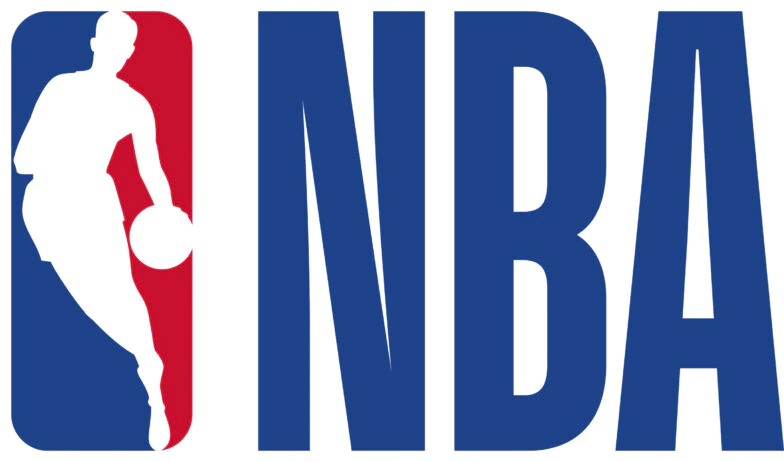

## Scope and Limitation

1. The game is ever-changing and evolving, officiating and trending playstyles are different per era of basketball. This means that only data from nearby seasons of a season that is to be targetted for prediction can be used for it.

2. If major rule changes are to take place right before a season that is to be subject to prediction given these methods, insights may lose weight. An example of this may include when the three-point line was introduced and the season after and/or maybe the season when zone defenses were introduced and the season after.

3. This kind of method of prediction may move differently in seasons where analytics were less evolved, with less of these stats introduced then.

4. In the same way, should newer, more substantial stats be introduced, results could change as well.

## Features

| Variable | Description |
| :--: | :--: |
| Team | Self-explanatory |
| Made playoffs? | Whether a team made the playoffs or not |
| FG per game | Field goals made per game |
| FGA per game | Field goals attempted per game |
| 3P per game | 3-pointers made per game |
| 3PA per game | 3-pointer attempted per game |
| 3P% | 3-pointer accuracy |
| 2P per game | 2-pointers made per game |
| 2PA per game | 2-pointer attempted per game |
| 2P% | 2-pointer accuracy |
| FT per game | Free throws made per game |
| FTA per game | Free throws attempted per game |
| FT% | Free throw accuracy |
| ORB | Offensive rebounds per game |
| DRB | Defensive rebounds per game |
| TRB | Total rebounds per game |
| AST per game | Assists per game |
| STL per game | Steals per game |
| BLK per game | Blocks per game |
| TOV per game | Turnovers per game |
| PF per game | Personal fouls per game |
| PTS per game | Points per game |
| Age | Average age of players in a team |
| W | Wins |
| L | Losses |
| PW | Predicted Wins |
| PL | Predicted Losses |
| MOV | Average Margin of Victory |
| SOS | Strength of Schedule |
| SRS | Simple Rating System (Average point differential and strength of schedule) |
| ORtg | Offensive Rating (Estimated points produced per 100 possessions) |
| DRtg | Defensive Rating (Estimated points allowed per 100 possessions) |
| NRtg | Net Rating (Estimate point differential per 100 possessions) |
| Pace | Estimate possessions per 48 minutes |
| FTr | Free Throw Attempt Rate |
| 3PAr | Three Point Attempt Rate |
| AST per game | Assists per game |
| TS% | Shooting efficiency accounting for 2-pointers, 3-pointers and free throws |
| O-eFG% | Field goal percentage except 3-pointers are given more weight since they're worth more points made by team |
| O-TOV% | Turnover Percentage made by team |
| ORB% | Offensive Rebound Percentage |
| O-FT/FGA | Free throws per field goal attempt by team |
| D-eFG% | Field goal percentage except 3-pointers are given more weight since they're worth more points allowed by team |
| D-TOV% | Turnover Percentage allowed by team |
| DRB% | Offensive Rebound Percentage allowed by team |
| D-FT/FGA | Free throws per field goal attempt allowed by team |
| Dist. | Average distance per field goal attempt |
| 2P FGA% | Percent of field goals attempted that are 2-pointers |
| 0-3 ft FGA% | Percent of field goals attempted attempted 0-3 feet away from the basket |
| 3-10 ft FGA% | Percent of field goals attempted attempted 3-10 feet away from the basket |
| 10-16 ft FGA% | Percent of field goals attempted attempted 10-16 feet away from the basket |
| 16-3P ft FGA% | Percent of field goals attempted attempted 16 feet to 3-point range from the basket |
| 3P FGA% | Percent of field goals attempted from 3-point range |
| 2P FG% | Percent of field goals attempted that are 2-pointers |
| 0-3 ft FG% | Accuracy of field goals attempted attempted 0-3 feet away from the basket |
| 3-10 ft FG% | Accuracy of field goals attempted attempted 3-10 feet away from the basket |
| 10-16 ft FG% | Accuracy of field goals attempted attempted 10-16 feet away from the basket |
| 16-3P ft FG% | Accuracy of field goals attempted attempted 16 feet to 3-point range from the basket |
| 3P FG% | Accuracy of field goals attempted from 3-point range |
| 2P | Percentage of 2-pointers that were assisted |
| 3P | Percentage of 3-pointers that were assisted |
| Dunks %FGA | Percent of field goals attempted that are dunks |
| Dunks Md. | Total number of dunks made |
| Layups %FGA | Percent of field goals attempted that are layups |
| Layups Md. | Total number of layups made |
| Corner %3PA | Percent of field goals attempted that are corner three-pointers |
| Corner %3P | Accuracy of corner three-pointer attempts |

Quantitative features are used for the histogram and scatterplot analysis.

## Methodology

1. Data compiling and organizing (Done outside the notebook)
2. Feature selection
3. Minmax scaling
4. Data splitting
5. Defining feature importance
6. Test performance

In [1]:
# %matplotlib inline
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.preprocessing import MinMaxScaler

from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import LinearSVC
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import train_test_split
from sklearn.linear_model import Ridge
from sklearn.linear_model import Lasso
import time

Matplotlib created a temporary config/cache directory at /tmp/matplotlib-7_705pgy because the default path (/home/jrjimenez/.cache/matplotlib) is not a writable directory; it is highly recommended to set the MPLCONFIGDIR environment variable to a writable directory, in particular to speed up the import of Matplotlib and to better support multiprocessing.


# Sheets and Dataframes

## All stats

In [3]:
file = 'NBA 2021-2022 Season.xlsx'

df = pd.read_excel(file)
df

,Team,Made Playoffs?,FG per game,FGA per game,FG%,3P per game,3PA per game,3P%,2P per game,2PA per game,...,16-3P FG%,3P FG%,2P,3P,Dunks %FGA,Dunks Md.,Layups %FGA,Layups Md.,Corner %3PA,Corner 3P%
0,Minnesota Timberwolves,1,41.6,91.0,0.457,14.8,41.3,0.358,26.8,49.7,...,0.366,0.358,0.519,0.797,0.066,429,0.278,1136,0.222,0.394
1,Memphis Grizzlies,1,43.5,94.4,0.461,11.5,32.7,0.353,32.0,61.7,...,0.382,0.353,0.504,0.854,0.056,384,0.272,1165,0.231,0.368
2,Milwaukee Bucks,1,41.8,89.4,0.468,14.1,38.4,0.366,27.8,51.0,...,0.395,0.366,0.461,0.789,0.049,317,0.251,1080,0.241,0.393
3,Charlotte Hornets,0,42.8,91.4,0.468,13.9,38.2,0.365,28.8,53.3,...,0.419,0.365,0.559,0.857,0.079,531,0.285,1141,0.287,0.372
4,Phoenix Suns,1,43.7,90.1,0.485,11.6,31.9,0.364,32.1,58.2,...,0.427,0.364,0.552,0.832,0.053,370,0.220,951,0.260,0.390
5,Atlanta Hawks,1,41.5,88.3,0.470,12.9,34.4,0.374,28.6,53.9,...,0.429,0.374,0.529,0.735,0.060,401,0.233,916,0.221,0.426
6,Utah Jazz,1,40.6,86.2,0.471,14.5,40.3,0.360,26.0,45.8,...,0.396,0.360,0.454,0.727,0.070,442,0.246,989,0.242,0.383
7,San Antonio Spurs,0,43.2,92.7,0.467,11.3,32.0,0.352,32.0,60.7,...,0.413,0.352,0.551,0.912,0.036,251,0.291,1254,0.230,0.368
8,Brooklyn Nets,1,42.0,88.4,0.475,11.5,31.7,0.361,30.5,56.7,...,0.478,0.361,0.541,0.764,0.053,338,0.251,982,0.235,0.393
9,Denver Nuggets,1,41.7,86.3,0.483,12.7,35.9,0.353,29.0,50.4,...,0.427,0.353,0.584,0.857,0.059,373,0.266,1128,0.265,0.384


In [4]:
df.describe()

,Made Playoffs?,FG per game,FGA per game,FG%,3P per game,3PA per game,3P%,2P per game,2PA per game,2P%,...,16-3P FG%,3P FG%,2P,3P,Dunks %FGA,Dunks Md.,Layups %FGA,Layups Md.,Corner %3PA,Corner 3P%
count,30.000000,30.000000,30.000000,30.000000,30.000000,30.000000,30.000000,30.000000,30.000000,30.000000,...,30.000000,30.000000,30.000000,30.000000,30.000000,30.000000,30.000000,30.000000,30.000000,30.000000
mean,0.533333,40.623333,88.090000,0.461233,12.440000,35.180000,0.353567,28.186667,52.923333,0.532967,...,0.396267,0.353567,0.511700,0.822767,0.057833,370.366667,0.264667,1068.666667,0.237300,0.382467
std,0.507416,1.606599,2.414946,0.014602,1.196431,3.057089,0.013910,2.075096,3.961947,0.019486,...,0.031697,0.013910,0.038043,0.043639,0.011528,71.396167,0.029252,129.649217,0.025759,0.022561
min,0.000000,37.700000,84.500000,0.430000,10.500000,28.800000,0.323000,24.500000,45.800000,0.497000,...,0.329000,0.323000,0.434000,0.727000,0.036000,251.000000,0.208000,833.000000,0.173000,0.332000
25%,0.000000,39.450000,86.325000,0.457000,11.525000,32.725000,0.346250,26.200000,50.300000,0.521000,...,0.377500,0.346250,0.498000,0.795500,0.050500,321.750000,0.245250,976.750000,0.219500,0.368250
50%,1.000000,40.600000,88.050000,0.466000,12.200000,35.000000,0.354000,27.950000,53.000000,0.536500,...,0.395000,0.354000,0.504500,0.823500,0.056500,366.000000,0.267000,1079.500000,0.235000,0.385000
75%,1.000000,41.675000,89.325000,0.469000,13.200000,37.325000,0.364000,29.450000,55.275000,0.543750,...,0.423500,0.364000,0.535750,0.856250,0.061750,402.500000,0.284250,1145.750000,0.251250,0.394000
max,1.000000,43.700000,94.400000,0.485000,14.800000,41.300000,0.379000,32.100000,61.700000,0.575000,...,0.478000,0.379000,0.595000,0.912000,0.089000,547.000000,0.320000,1326.000000,0.296000,0.426000


## Basic Stats

In [5]:
df_basic = pd.read_excel(file, 'Basic Stats', index_col=0)
df_basic

,Team,G,MP,FG,FGA,FG%,3P,3PA,3P%,2P,...,ORB,DRB,TRB,AST,STL,BLK,TOV,PF,PTS,Made playoffs?
Rk,,,,,,,,,,,,,,,,,,,,,
1,Minnesota Timberwolves,82,241.2,41.6,91.0,0.457,14.8,41.3,0.358,26.8,...,11.2,32.9,44.2,25.7,8.8,5.6,14.3,21.8,115.9,1
2,Memphis Grizzlies,82,241.2,43.5,94.4,0.461,11.5,32.7,0.353,32.0,...,14.1,35.0,49.2,26.0,9.8,6.5,13.2,19.8,115.6,1
3,Milwaukee Bucks,82,240.9,41.8,89.4,0.468,14.1,38.4,0.366,27.8,...,10.2,36.5,46.7,23.9,7.6,4.0,13.4,18.2,115.5,1
4,Charlotte Hornets,82,242.4,42.8,91.4,0.468,13.9,38.2,0.365,28.8,...,10.8,33.7,44.6,28.1,8.6,4.9,13.3,19.9,115.3,0
5,Phoenix Suns,82,240.6,43.7,90.1,0.485,11.6,31.9,0.364,32.1,...,9.8,35.5,45.3,27.4,8.6,4.4,12.9,19.9,114.8,1
6,Atlanta Hawks,82,240.3,41.5,88.3,0.470,12.9,34.4,0.374,28.6,...,10.0,33.9,44.0,24.6,7.2,4.2,11.9,18.7,113.9,1
7,Utah Jazz,82,240.6,40.6,86.2,0.471,14.5,40.3,0.360,26.0,...,10.8,35.6,46.3,22.4,7.2,4.9,14.0,18.9,113.6,1
8,San Antonio Spurs,82,241.5,43.2,92.7,0.467,11.3,32.0,0.352,32.0,...,11.0,34.3,45.3,27.9,7.6,4.9,12.7,18.1,113.2,0
9,Brooklyn Nets,82,240.9,42.0,88.4,0.475,11.5,31.7,0.361,30.5,...,10.3,34.1,44.4,25.3,7.1,5.5,14.1,20.4,112.9,1


## Advanced Stats

In [6]:
df_advanced = pd.read_excel(file, 'Advanced Stats', index_col=0)
df_advanced

,Team,Age,W,L,ORtg,DRtg,Pace,FTr,3PAr,TS%,O-eFG%,O-TOV%,ORB%,O-FT/FGA,D-eFG%,D-TOV%,DRB%,D-FT/FGA,Made playoffs?
Rk,,,,,,,,,,,,,,,,,,,
1,Boston Celtics,26.1,51,31,114.4,106.9,96.6,0.239,0.425,0.578,0.542,12.4,24.0,0.195,0.502,12.5,77.3,0.183,1
2,Phoenix Suns,27.5,64,18,114.8,107.3,99.8,0.221,0.354,0.581,0.549,11.6,22.3,0.176,0.510,13.0,77.1,0.195,1
3,Utah Jazz,29.3,49,33,116.7,110.5,97.1,0.271,0.468,0.589,0.555,12.7,25.4,0.208,0.521,10.9,78.3,0.164,1
4,Memphis Grizzlies,24.0,56,26,114.6,109.0,100.3,0.245,0.346,0.553,0.522,11.2,30.0,0.180,0.523,13.3,77.8,0.195,1
5,Golden State Warriors,27.6,53,29,112.5,106.9,98.4,0.235,0.456,0.582,0.552,13.5,22.8,0.181,0.509,13.0,78.7,0.201,1
6,Miami Heat,28.2,53,29,113.7,109.1,95.9,0.252,0.422,0.584,0.547,13.4,23.5,0.204,0.524,13.8,78.0,0.209,1
7,Dallas Mavericks,26.7,52,30,112.8,109.4,95.4,0.249,0.439,0.572,0.538,11.7,21.3,0.192,0.521,12.2,78.0,0.185,1
8,Milwaukee Bucks,28.5,51,31,115.1,111.8,99.9,0.257,0.430,0.580,0.546,11.9,23.0,0.199,0.536,11.6,78.6,0.165,1
9,Philadelphia 76ers,26.8,51,31,113.5,110.8,96.2,0.282,0.376,0.578,0.534,11.6,20.1,0.232,0.524,12.1,76.8,0.192,1


## Shooting Stats

In [7]:
df_shooting = pd.read_excel(file, 'Shooting Stats', index_col=0)
df_shooting

,Team,G,MP,FG%,Dist.,2P FGA%,0-3 ft FGA%,3-10 ft FGA%,10-16 ft FGA%,16-3P FGA%,...,3P FG%,2P,3P,Dunks %FGA,Dunks Md.,Layups %FGA,Layups Md.,Corner %3PA,Corner 3P%,Made playoffs?
Rk,,,,,,,,,,,,,,,,,,,,,
1,Atlanta Hawks,82,19705,0.470,14.5,0.610,0.246,0.164,0.111,0.089,...,0.374,0.529,0.735,0.060,401,0.233,916,0.221,0.426,1
2,Boston Celtics,82,19905,0.466,14.8,0.575,0.218,0.203,0.082,0.073,...,0.356,0.512,0.813,0.058,370,0.276,1147,0.231,0.389,1
3,Brooklyn Nets,82,19755,0.475,13.9,0.641,0.245,0.166,0.136,0.094,...,0.361,0.541,0.764,0.053,338,0.251,982,0.235,0.393,1
4,Chicago Bulls,82,19730,0.480,13.8,0.668,0.259,0.151,0.127,0.131,...,0.369,0.476,0.852,0.050,321,0.247,1019,0.273,0.418,1
5,Charlotte Hornets,82,19880,0.468,13.9,0.582,0.290,0.177,0.069,0.047,...,0.365,0.559,0.857,0.079,531,0.285,1141,0.287,0.372,0
6,Cleveland Cavaliers,82,19730,0.469,13.7,0.613,0.284,0.182,0.091,0.056,...,0.355,0.556,0.822,0.080,501,0.243,944,0.235,0.332,0
7,Dallas Mavericks,82,19755,0.461,15.3,0.561,0.206,0.176,0.108,0.071,...,0.350,0.502,0.783,0.059,357,0.208,874,0.262,0.398,1
8,Denver Nuggets,82,19805,0.483,14.4,0.584,0.236,0.204,0.073,0.071,...,0.353,0.584,0.857,0.059,373,0.266,1128,0.265,0.384,1
9,Detroit Pistons,82,19780,0.431,14.0,0.609,0.247,0.209,0.081,0.073,...,0.326,0.498,0.893,0.039,257,0.304,1187,0.267,0.361,0


## Predictive Stats

In [8]:
df_predictive = pd.read_excel(file, 'Predictive Stats', index_col=0)
df_predictive

,Team,PW,PL,NRtg,MOV,SOS,SRS
Rk,,,,,,,
1,Boston Celtics,59,23,7.5,7.28,-0.26,7.02
2,Phoenix Suns,59,23,7.5,7.50,-0.56,6.94
3,Utah Jazz,56,26,6.2,6.04,-0.37,5.67
4,Memphis Grizzlies,55,27,5.6,5.68,-0.32,5.37
5,Golden State Warriors,55,27,5.6,5.54,-0.02,5.52
6,Miami Heat,53,29,4.6,4.45,-0.22,4.23
7,Dallas Mavericks,50,32,3.4,3.30,-0.18,3.12
8,Milwaukee Bucks,49,33,3.3,3.35,-0.14,3.22
9,Philadelphia 76ers,48,34,2.7,2.61,-0.04,2.57


# Histograms

## Basic stats per game Histograms

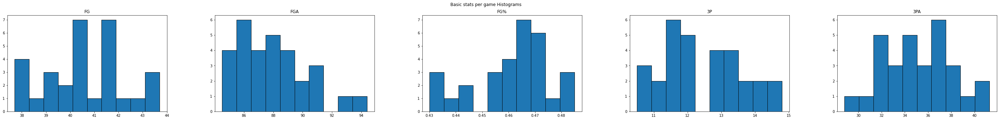

In [12]:
fig, ax = plt.subplots(1, 5, figsize=(50, 5))
df_basic[['FG','FGA','FG%','3P','3PA']].hist(ax=ax,
                                         grid=False,
                                         edgecolor='black')
plt.suptitle('Basic stats per game Histograms')
plt.show()

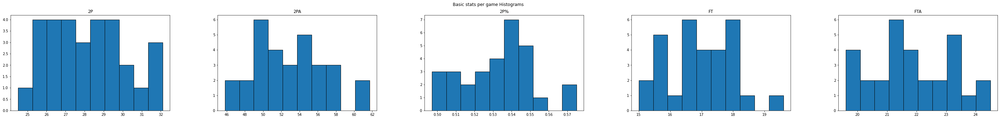

In [13]:
fig, ax = plt.subplots(1, 5, figsize=(50, 5))
df_basic[['2P','2PA','2P%','FT','FTA']].hist(ax=ax,
                                         grid=False,
                                         edgecolor='black')
plt.suptitle('Basic stats per game Histograms')
plt.show()

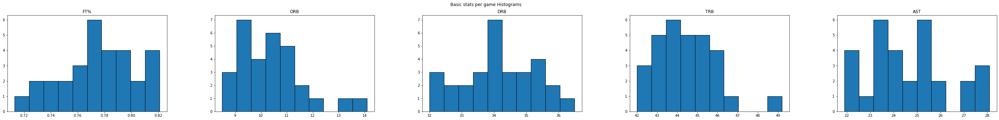

In [14]:
fig, ax = plt.subplots(1, 5, figsize=(50, 5))
df_basic[['FT%','ORB','DRB','TRB','AST']].hist(ax=ax,
                                         grid=False,
                                         edgecolor='black')
plt.suptitle('Basic stats per game Histograms')
plt.show()

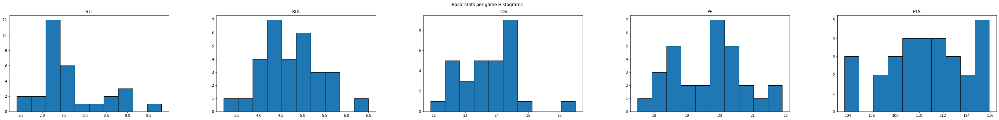

In [15]:
fig, ax = plt.subplots(1, 5, figsize=(50, 5))
df_basic[['STL','BLK','TOV','PF','PTS']].hist(ax=ax,
                                         grid=False,
                                         edgecolor='black')
plt.suptitle('Basic stats per game Histograms')
plt.show()

## Advanced Stats Histograms

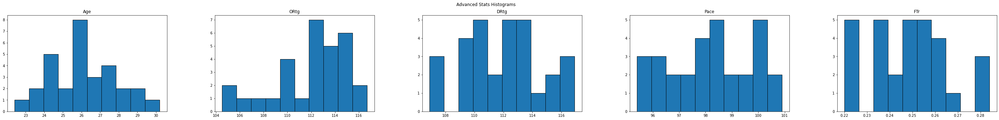

In [16]:
fig, ax = plt.subplots(1, 5, figsize=(50, 5))
df_advanced[['Age', 'ORtg', 'DRtg', 'Pace', 'FTr']].hist(ax=ax,
                                         grid=False,
                                         edgecolor='black')
plt.suptitle('Advanced Stats Histograms')
plt.show()

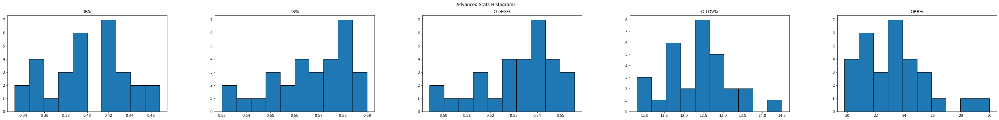

In [17]:
fig, ax = plt.subplots(1, 5, figsize=(50, 5))
df_advanced[['3PAr', 'TS%', 'O-eFG%', 'O-TOV%', 'ORB%']].hist(ax=ax,
                                         grid=False,
                                         edgecolor='black')
plt.suptitle('Advanced Stats Histograms')
plt.show()

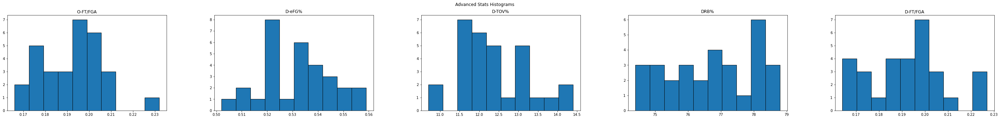

In [18]:
fig, ax = plt.subplots(1, 5, figsize=(50, 5))
df_advanced[['O-FT/FGA', 'D-eFG%', 'D-TOV%', 'DRB%', 'D-FT/FGA']].hist(ax=ax,
                                         grid=False,
                                         edgecolor='black')
plt.suptitle('Advanced Stats Histograms')
plt.show()

## Shooting Stats Histogram

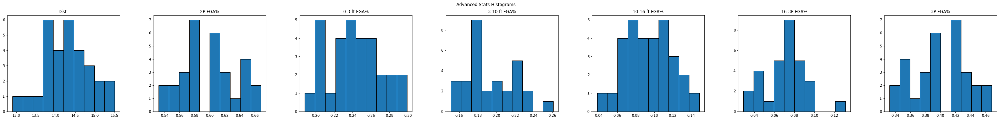

In [19]:
fig, ax = plt.subplots(1, 7, figsize=(50, 5))
df_shooting[['Dist.', '2P FGA%', '0-3 ft FGA%', '3-10 ft FGA%',
             '10-16 ft FGA%', '16-3P FGA%', '3P FGA%']].hist(ax=ax,
                                         grid=False,
                                         edgecolor='black')
plt.suptitle('Advanced Stats Histograms')
plt.show()

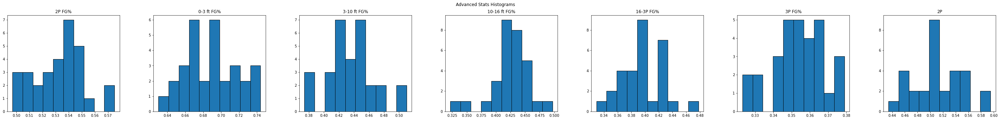

In [20]:
fig, ax = plt.subplots(1, 7, figsize=(50, 5))
df_shooting[['2P FG%', '0-3 ft FG%', '3-10 ft FG%', '10-16 ft FG%',
             '16-3P FG%', '3P FG%', '2P']].hist(ax=ax,
                                         grid=False,
                                         edgecolor='black')
plt.suptitle('Advanced Stats Histograms')
plt.show()

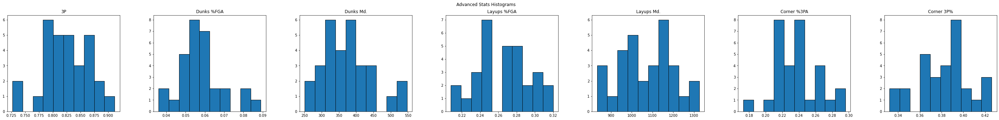

In [21]:
fig, ax = plt.subplots(1, 7, figsize=(50, 5))
df_shooting[['3P', 'Dunks %FGA', 'Dunks Md.', 'Layups %FGA',
             'Layups Md.', 'Corner %3PA', 'Corner 3P%']].hist(ax=ax,
                                         grid=False,
                                         edgecolor='black')
plt.suptitle('Advanced Stats Histograms')
plt.show()

# Pair Plot

## All Stats

In [24]:
sns.pairplot(df.drop(['Team', 'W', 'L'], axis=1), hue='Made Playoffs?')
plt.show()

## Basic Stats

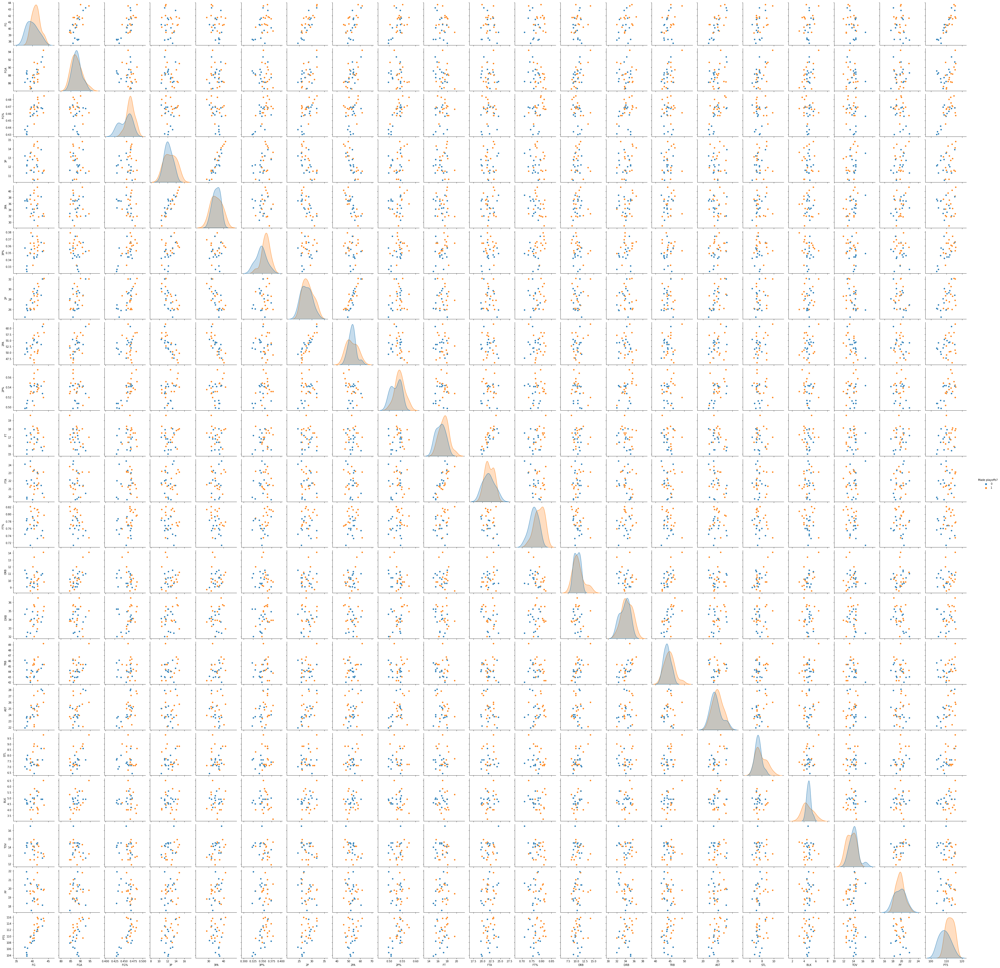

In [19]:
df_basic_3 = df_basic.drop(['Team','G','MP'], axis=1)
sns.pairplot(df_basic_3, hue='Made playoffs?')
plt.show()

## Advanced Stats

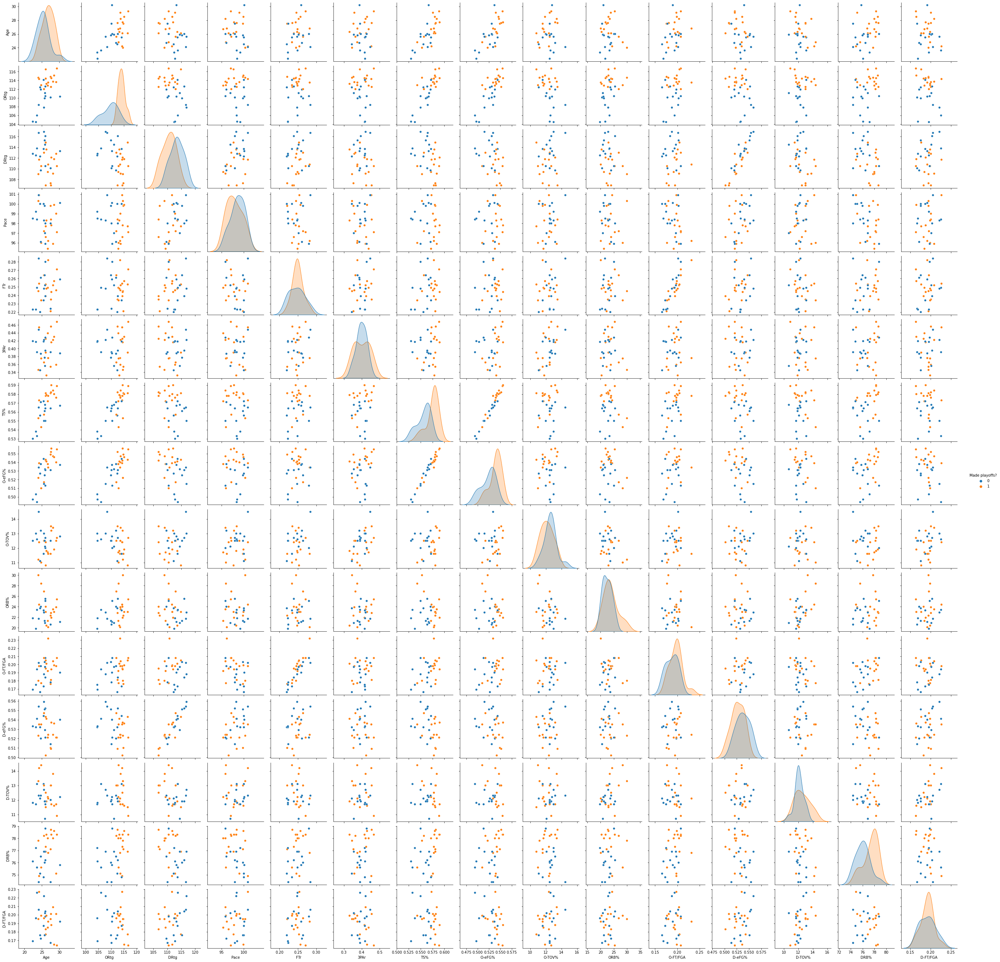

In [21]:
sns.pairplot(df_advanced.drop(['Team', 'W', 'L'], axis=1), hue='Made playoffs?')
plt.show()

## Shooting Stats

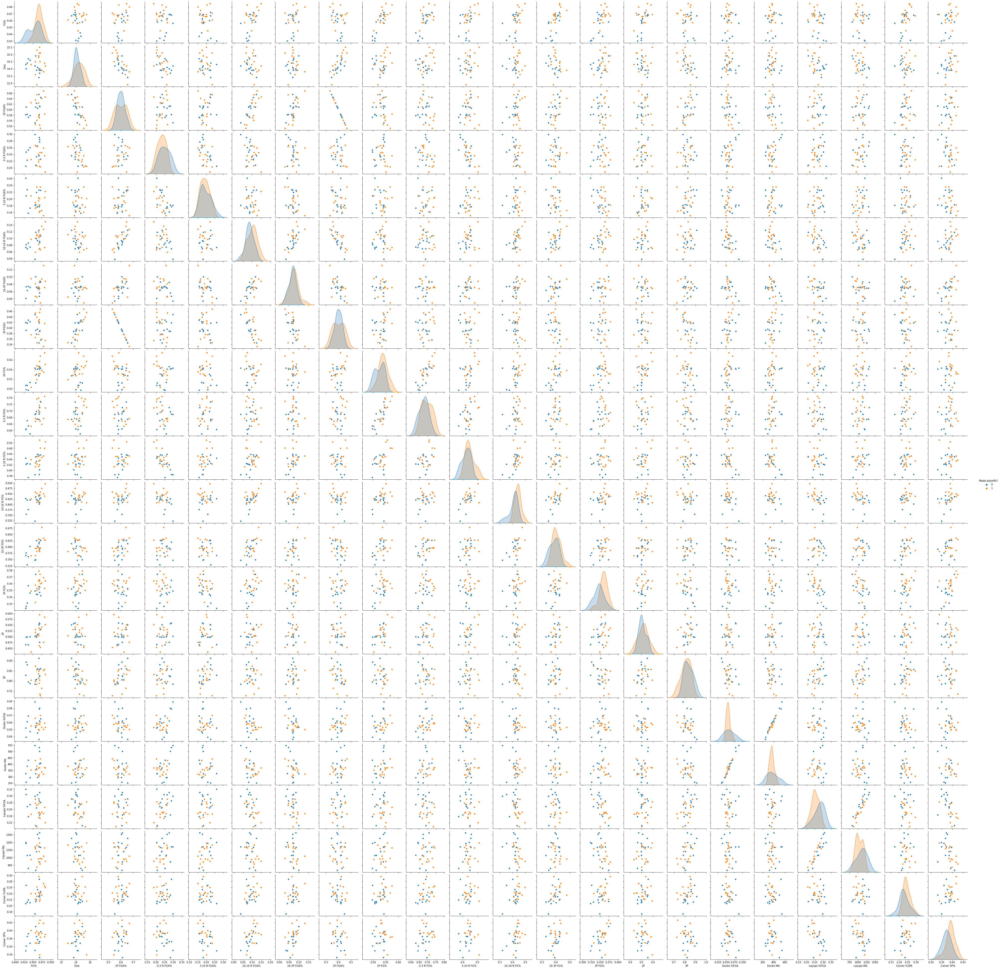

In [22]:
data = df_shooting.drop(['Team', 'G', 'MP'], axis=1)
sns.pairplot(data, hue='Made playoffs?')
plt.show()

## Pair Plots Highlights

### Apparent collinearities
* The more two-pointers you attempt, the higher your 2P FGA% and 2-pointers made are; same applies with three-pointers and related stats
* The higher your 3P FGA%, the lower your 2P FGA% is and 2-pointers attempted and made are
* The more attempts you have, the more makes you'll have (That's how volume shooting works)
* General accuracy stats are collinear with derived accuracy stats such as TS% and eFG%
* Higher average distance means less 0-3 and 3-10 ft FGA% and more 10-16 and 16-3P FGA%, it can also mean more three-pointers attempted per game

### Interesting insights
* Age average and FG%: May suggest with age comes both maturity and wiser shot selection and therefore a more refined skillset
* Turnovers and steals not having collinearity: Turnovers don't always translate to steals, this is because it could happen from committing violations and stepping out of bounds
* Steals and dunks/layups not having collinearity: Steals don't always translate to dunks or layups, converting points out of turnovers is an art and entirely new challenge in itself - transitions in between playing offense and defense are important

# Automated Machine Learning

## All Stats

### Data pre-processing

In [160]:
df.isna().sum()

Team              0
Made Playoffs?    0
FG per game       0
FGA per game      0
FG%               0
                 ..
Dunks Md.         0
Layups %FGA       0
Layups Md.        0
Corner %3PA       0
Corner 3P%        0
Length: 61, dtype: int64

In [161]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30 entries, 0 to 29
Data columns (total 61 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   Team            30 non-null     object 
 1   Made Playoffs?  30 non-null     int64  
 2   FG per game     30 non-null     float64
 3   FGA per game    30 non-null     float64
 4   FG%             30 non-null     float64
 5   3P per game     30 non-null     float64
 6   3PA per game    30 non-null     float64
 7   3P%             30 non-null     float64
 8   2P per game     30 non-null     float64
 9   2PA per game    30 non-null     float64
 10  2P%             30 non-null     float64
 11  FT per game     30 non-null     float64
 12  FTA per game    30 non-null     float64
 13  FT%             30 non-null     float64
 14  ORB per game    30 non-null     float64
 15  DRB per game    30 non-null     float64
 16  TRB per game    30 non-null     float64
 17  AST per game    30 non-null     float

In [162]:
X = df.drop(['Team','Made Playoffs?','W','L'], axis=1)
X.head()

,FG per game,FGA per game,FG%,3P per game,3PA per game,3P%,2P per game,2PA per game,2P%,FT per game,...,16-3P FG%,3P FG%,2P,3P,Dunks %FGA,Dunks Md.,Layups %FGA,Layups Md.,Corner %3PA,Corner 3P%
0,41.6,91.0,0.457,14.8,41.3,0.358,26.8,49.7,0.540,18.0,...,0.366,0.358,0.519,0.797,0.066,429,0.278,1136,0.222,0.394
1,43.5,94.4,0.461,11.5,32.7,0.353,32.0,61.7,0.519,17.0,...,0.382,0.353,0.504,0.854,0.056,384,0.272,1165,0.231,0.368
2,41.8,89.4,0.468,14.1,38.4,0.366,27.8,51.0,0.544,17.8,...,0.395,0.366,0.461,0.789,0.049,317,0.251,1080,0.241,0.393
3,42.8,91.4,0.468,13.9,38.2,0.365,28.8,53.3,0.542,15.8,...,0.419,0.365,0.559,0.857,0.079,531,0.285,1141,0.287,0.372
4,43.7,90.1,0.485,11.6,31.9,0.364,32.1,58.2,0.551,15.9,...,0.427,0.364,0.552,0.832,0.053,370,0.220,951,0.260,0.390


Feature selection and splitting were applied here. Team identity is supposed to be irrelevant here and wins and losses would just be too obvious as predictor variables for over and underachieving teams respectively. Wins and losses are stats as well that are gained through the season, while averages are merely accumulated but already there from the beginning.

In [163]:
sscaler = MinMaxScaler()
X_2 = sscaler.fit_transform(X.astype(np.float)) #You will loss the column names

/tmp/ipykernel_149/4128993665.py:2: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  X_2 = sscaler.fit_transform(X.astype(np.float)) #You will loss the column names


Having experimented with none, Standard, Minmax and Robust scalers; Minmax yielded the best results among all other scalers.

In [164]:
X_df = pd.DataFrame(data=X_2, columns=X.columns)
X_df.head()

,FG per game,FGA per game,FG%,3P per game,3PA per game,3P%,2P per game,2PA per game,2P%,FT per game,...,16-3P FG%,3P FG%,2P,3P,Dunks %FGA,Dunks Md.,Layups %FGA,Layups Md.,Corner %3PA,Corner 3P%
0,0.650000,0.656566,0.490909,1.000000,1.000,0.625000,0.302632,0.245283,0.551282,0.652174,...,0.248322,0.625000,0.527950,0.378378,0.566038,0.601351,0.625000,0.614604,0.398374,0.659574
1,0.966667,1.000000,0.563636,0.232558,0.312,0.535714,0.986842,1.000000,0.282051,0.434783,...,0.355705,0.535714,0.434783,0.686486,0.377358,0.449324,0.571429,0.673428,0.471545,0.382979
2,0.683333,0.494949,0.690909,0.837209,0.768,0.767857,0.434211,0.327044,0.602564,0.608696,...,0.442953,0.767857,0.167702,0.335135,0.245283,0.222973,0.383929,0.501014,0.552846,0.648936
3,0.850000,0.696970,0.690909,0.790698,0.752,0.750000,0.565789,0.471698,0.576923,0.173913,...,0.604027,0.750000,0.776398,0.702703,0.811321,0.945946,0.687500,0.624746,0.926829,0.425532
4,1.000000,0.565657,1.000000,0.255814,0.248,0.732143,1.000000,0.779874,0.692308,0.195652,...,0.657718,0.732143,0.732919,0.567568,0.320755,0.402027,0.107143,0.239351,0.707317,0.617021


In [165]:
y = df['Made Playoffs?']
y.head()

0    1
1    1
2    1
3    0
4    1
Name: Made Playoffs?, dtype: int64

## Model Testing

In [166]:
target = df['Made Playoffs?'].to_numpy()
features = df.loc[:, 'FG per game':'Corner 3P%'].to_numpy()

Target and features here were set to find train and test shapes.

In [167]:
X_train, X_test, y_train, y_test = train_test_split(features, target, test_size=0.25, random_state=0)

print("X_train shape: {}".format(X_train.shape))
print("Y_train shape: {}".format(y_train.shape))

print("X_test shape: {}".format(X_test.shape))
print("Y_test shape: {}".format(y_test.shape))

X_train shape: (22, 59)
Y_train shape: (22,)
X_test shape: (8, 59)
Y_test shape: (8,)


In [168]:
trials = 30
Number_trials = trials

def train_knn(X, y):
    all_train = []
    all_test = []
    for seed in range(trials):
        X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=seed)
        n_train = []
        n_test = []
        for n_neighbor in range(1, len(X_train)):
            model =  KNeighborsClassifier(n_neighbors=n_neighbor).fit(X_train, y_train)
            n_train.append(model.score(X_train, y_train))
            n_test.append(model.score(X_test, y_test))
        all_train.append(n_train)
        all_test.append(n_test)
    train_score = np.mean(all_train, axis=0)
    test_score = np.mean(all_test, axis=0)
    run_time = (time.time() - start_time)
    fig = plt.figure(figsize=(15, 20))
    return ['kNN', np.amax(test_score), f'N_Neighbor = {np.argmax(test_score)+1}', 'NA', run_time]

def train_logistic(X, y, reg):
    C = [1, 1.5, 3, 5, 10, 15,  20, 100, 300, 1000, 5000]
    all_train = []
    all_test = []
    all_coeffs=[]
    for seed in range(trials):
        X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=seed)
        c_train = []
        c_test = []
        for alpha_run in C:
            if reg == 'l1':
                lr = LogisticRegression(C=alpha_run, penalty=reg, solver='liblinear', max_iter=1_000_000).fit(X_train, y_train)
            if reg == 'l2':
                lr = LogisticRegression(C=alpha_run, penalty=reg, dual=False, max_iter=1_000_000).fit(X_train, y_train)
            c_train.append(lr.score(X_train, y_train))
            c_test.append(lr.score(X_test, y_test))
            all_coeffs.append(lr.coef_)
        all_train.append(c_train)
        all_test.append(c_test)  
    mean_coeffs = np.mean(all_coeffs, axis=0).mean(axis=0)
    top_predictor = X.columns[np.argmax(np.abs(mean_coeffs))]
    train_score = np.mean(all_train, axis=0)
    test_score = np.mean(all_test, axis=0)
    run_time = (time.time() - start_time)    
    fig = plt.figure(figsize=(15, 20))
    plt.barh(X.columns, mean_coeffs)
    plt.title(f'Logistic ({reg}) coefficients')
    plt.show
    return [f'Logistic ({reg})', np.amax(test_score),
            f'C = {C[np.argmax(test_score)]}', top_predictor, run_time]

def train_svm(X, y, reg):
    C = [1, 1.5, 3, 5, 10, 15,  20, 100, 300, 1000, 5000]
    all_train = []
    all_test = []
    all_coeffs=[]
    for seed in range(trials):
        X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=seed)
        c_train = []
        c_test = []
        for alpha_run in C:
            if reg == 'l1':
                svc = LinearSVC(C=alpha_run, penalty=reg, loss='squared_hinge', dual=False, max_iter=1_000_000).fit(X_train, y_train)
            if reg == 'l2':
                svc = LinearSVC(C=alpha_run, penalty=reg, max_iter=1_000_000).fit(X_train, y_train)
            c_train.append(svc.score(X_train, y_train))
            c_test.append(svc.score(X_test, y_test))
            all_coeffs.append(svc.coef_)
        all_train.append(c_train)
        all_test.append(c_test)
    mean_coeffs = np.mean(all_coeffs, axis=0).mean(axis=0)
    top_predictor = X.columns[np.argmax(np.abs(mean_coeffs))]
    train_score = np.mean(all_train, axis=0)
    test_score = np.mean(all_test, axis=0)
    run_time = (time.time() - start_time)
    fig = plt.figure(figsize=(15, 20))
    plt.barh(X.columns, mean_coeffs)
    plt.title(f'Linear SVM ({reg}) coefficients')    
    plt.show
    return [f'LinearSVM ({reg})', np.amax(test_score), f'C = {C[np.argmax(test_score)]}', top_predictor, run_time]

def train_RF(X, y, reg):
    max_features_tuning=[0.1, .2, .3, .4, .5, .7, .8]
    #C = [.01, .1]
    score_train = []
    score_test = []
    weighted_coefs=[]
    
    for seed in range(Number_trials):
        training_accuracy = []  
        test_accuracy = []
        X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=seed)
        for max_features_run in max_features_tuning:
            svc = RandomForestClassifier(n_estimators=100, max_features=max_features_run).fit(X_train, y_train)
            training_accuracy.append(svc.score(X_train, y_train))
            test_accuracy.append(svc.score(X_test, y_test))
           # if alpha_run == 0.01:
            coefs = svc.feature_importances_
            weighted_coefs.append(coefs)
                
        score_train.append(training_accuracy)
        score_test.append(test_accuracy)
 

    mean_coefs=np.mean(weighted_coefs, axis=0) #get the mean of the weighted coefficients over all the trials       
    score = np.mean(score_test, axis=0)
    

    top_predictor=X.columns[np.argmax(np.abs(mean_coefs))]
    abs_mean_coefs = np.abs(mean_coefs[:])
    coefs_count = len(abs_mean_coefs)
    fig = plt.figure(figsize=(15, 20))
    plt.barh(X.columns, mean_coefs)
    plt.title(f'Random Forest coefficients')    
    plt.show
    run_time = (time.time() - start_time)
    return ['Random Forest', np.amax(score), \
            'Max_features = {0}'.format(max_features_tuning[np.argmax(score)]), top_predictor,run_time]

def train_GBM(X, y, reg):
    max_features_tuning=[0.1, .2, .3, .4, .5, .7, .8]
    #C = [.01, .1]
    score_train = []
    score_test = []
    weighted_coefs=[]
    
    for seed in range(Number_trials):
        training_accuracy = []  
        test_accuracy = []
        X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=seed)
        for max_features_run in max_features_tuning:
            svc = GradientBoostingClassifier(n_estimators=100,max_depth=3, max_features=max_features_run).fit(X_train, y_train)
            training_accuracy.append(svc.score(X_train, y_train))
            test_accuracy.append(svc.score(X_test, y_test))
           # if alpha_run == 0.01:
            coefs = svc.feature_importances_
            weighted_coefs.append(coefs)
                
        score_train.append(training_accuracy)
        score_test.append(test_accuracy)
 

    mean_coefs=np.mean(weighted_coefs, axis=0) #get the mean of the weighted coefficients over all the trials       
    score = np.mean(score_test, axis=0)
    

    top_predictor=X.columns[np.argmax(np.abs(mean_coefs))]
    abs_mean_coefs = np.abs(mean_coefs[:])
    coefs_count = len(abs_mean_coefs)
    fig = plt.figure(figsize=(15, 20))
    plt.barh(X.columns, mean_coefs)
    plt.title(f'Gradient Boosting coefficients')    
    plt.show
    run_time = (time.time() - start_time)
    return ['Gradient Boosting Method', np.amax(score), \
            'Max_features = {0}'.format(max_features_tuning[np.argmax(score)]), top_predictor,run_time]

This includes horizontal bar graphs for ranking coefficients per machine learning model.

## Feature Importance

['kNN', 0.7416666666666667, 'N_Neighbor = 4', 'NA', 132.70750212669373]
132.70750212669373 seconds
['Logistic (l2)', 0.8541666666666666, 'C = 300', 'FT%', 3.395071029663086]
3.395071029663086 seconds
['Logistic (l1)', 0.7833333333333333, 'C = 5000', 'DRtg', 1.7035539150238037]
1.7035539150238037 seconds
['LinearSVM (l2)', 0.8916666666666667, 'C = 300', 'DRtg', 1.830221176147461]
1.830221176147461 seconds
['LinearSVM (l1)', 0.8458333333333333, 'C = 5000', 'DRtg', 5.322010517120361]
5.322010517120361 seconds
['Random Forest', 0.7708333333333334, 'Max_features = 0.4', 'ORtg', 32.10479950904846]
32.10479950904846 seconds
['Gradient Boosting Method', 0.7708333333333334, 'Max_features = 0.5', 'ORtg', 11.186385154724121]
32.10479950904846 seconds


<Figure size 1080x1440 with 0 Axes>

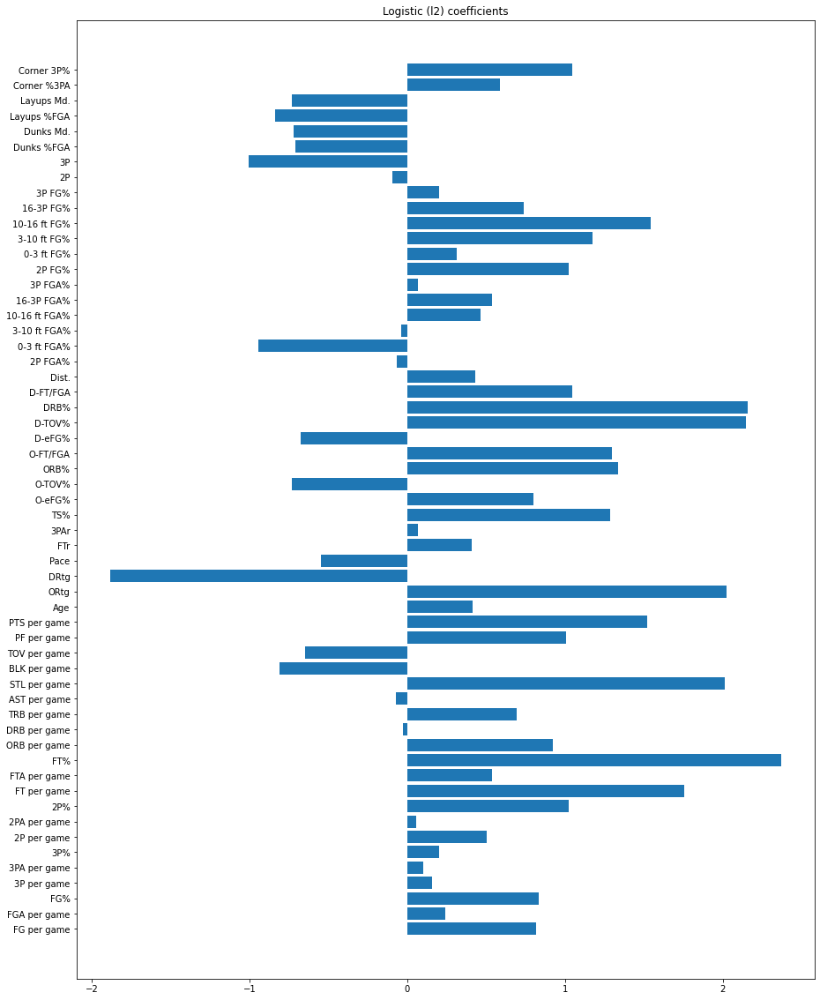

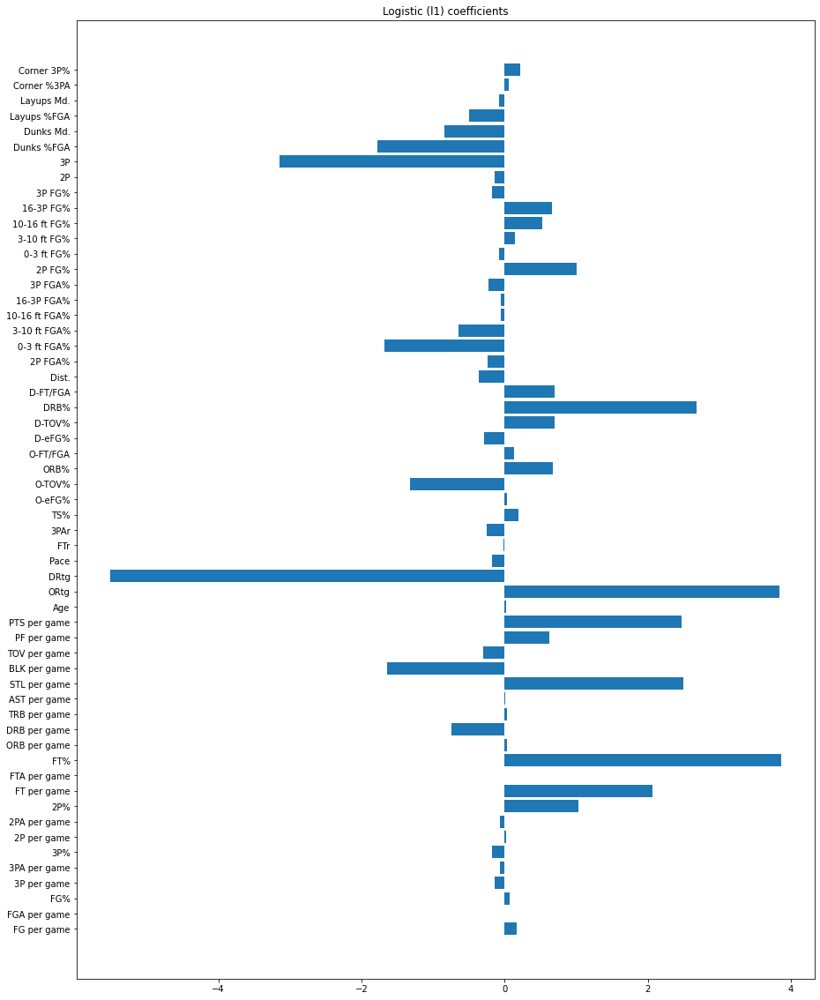

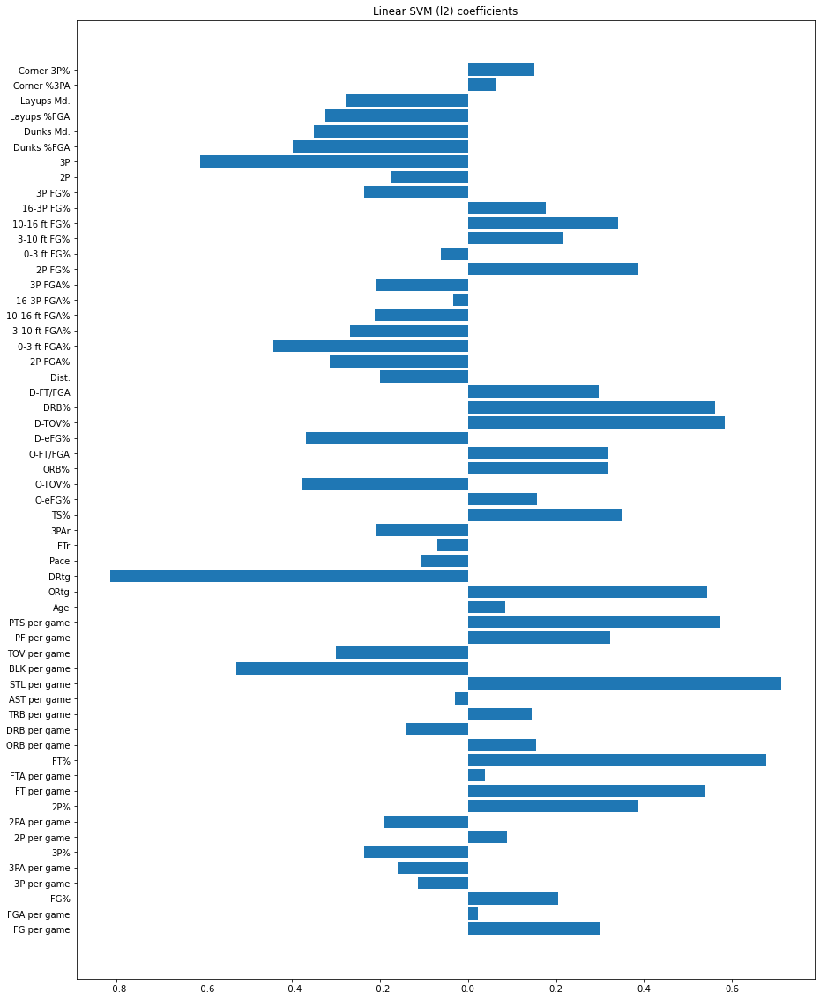

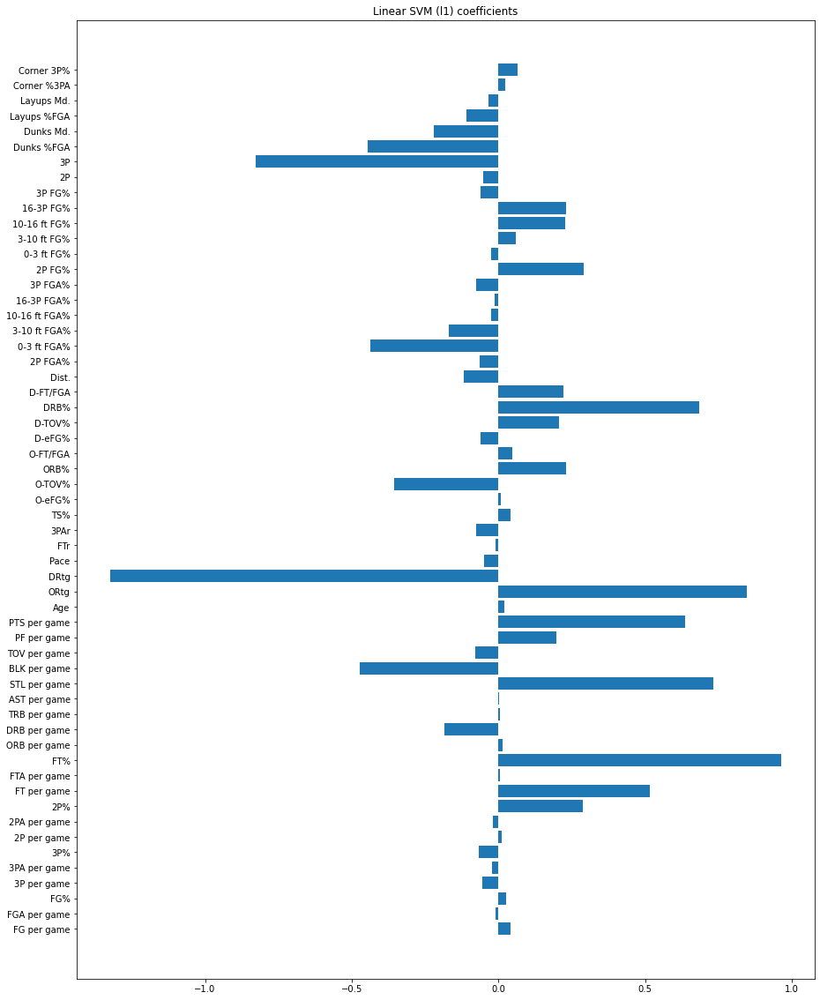

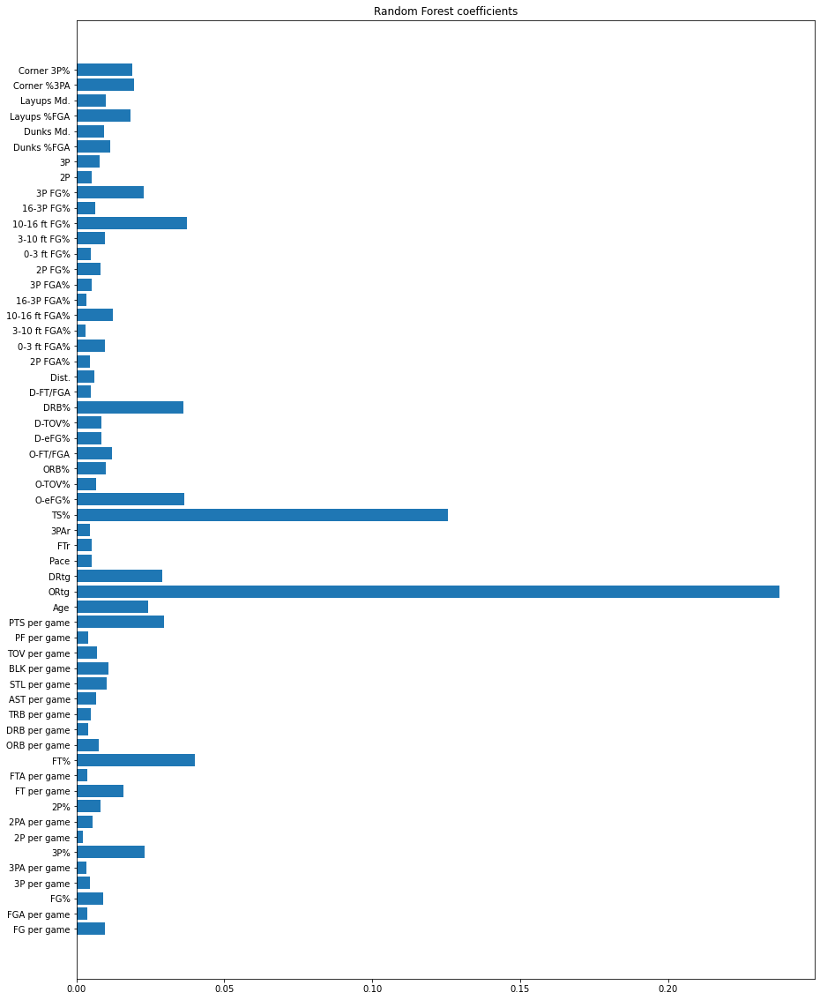

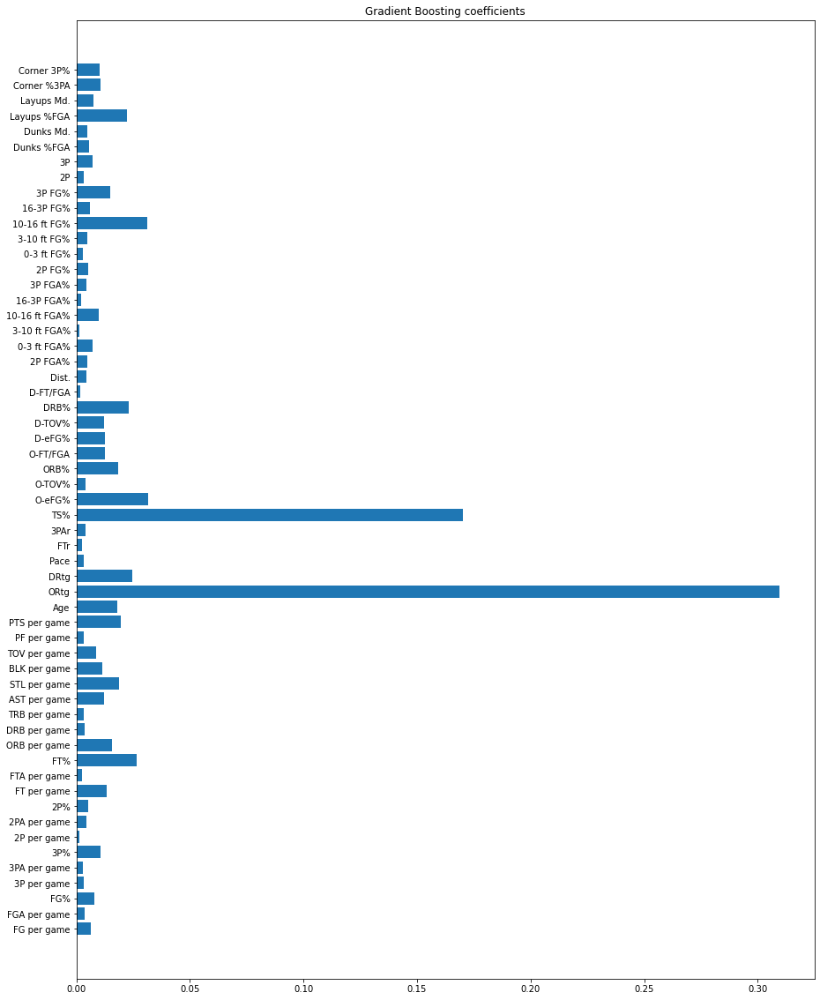

In [169]:
X = X_df

y = y

start_time = time.time()
a = train_knn(X,y)
print(a)
print("%s seconds" % a[4])

start_time = time.time()
b = train_logistic(X,y,reg='l2')
print(b)
print("%s seconds" % b[4])

start_time = time.time()
c = train_logistic(X,y,reg='l1')
print(c)
print("%s seconds" % c[4])

start_time = time.time()
d = train_svm(X,y,reg='l2')
print(d)
print("%s seconds" % d[4])

start_time = time.time()
e = train_svm(X,y,reg='l1')
print(e)
print("%s seconds" % e[4])

start_time = time.time()
f = train_RF(X,y,reg='none')
print(f)
print("%s seconds" % f[4])

start_time = time.time()
g = train_GBM(X,y,reg='none')
print(g)
print("%s seconds" % f[4])

## Test Performance

In [170]:
columns = ['Machine Learning Method', 'Test Accuracy',
        'Best Parameter', 'Top Predictor Variable', 'Run Time']
result = pd.DataFrame(columns=columns)
result.loc[0] = a
result.loc[1] = b
result.loc[2] = c
result.loc[3] = d
result.loc[4] = e
result.loc[5] = f
result.loc[6] = g
result

,Machine Learning Method,Test Accuracy,Best Parameter,Top Predictor Variable,Run Time
0,kNN,0.741667,N_Neighbor = 4,NA,132.707502
1,Logistic (l2),0.854167,C = 300,FT%,3.395071
2,Logistic (l1),0.783333,C = 5000,DRtg,1.703554
3,LinearSVM (l2),0.891667,C = 300,DRtg,1.830221
4,LinearSVM (l1),0.845833,C = 5000,DRtg,5.322011
5,Random Forest,0.770833,Max_features = 0.4,ORtg,32.104800
6,Gradient Boosting Method,0.770833,Max_features = 0.5,ORtg,11.186385


In here, we see that defense rating edges out other predictor variables, with offense rating following not so far behind it.

## All Stats without ORtg, DRtg and PPG

### Data pre-processing

In [171]:
X = df.drop(['Team','Made Playoffs?','W','L','ORtg','DRtg','PTS per game'], axis=1)
X.head()

,FG per game,FGA per game,FG%,3P per game,3PA per game,3P%,2P per game,2PA per game,2P%,FT per game,...,16-3P FG%,3P FG%,2P,3P,Dunks %FGA,Dunks Md.,Layups %FGA,Layups Md.,Corner %3PA,Corner 3P%
0,41.6,91.0,0.457,14.8,41.3,0.358,26.8,49.7,0.540,18.0,...,0.366,0.358,0.519,0.797,0.066,429,0.278,1136,0.222,0.394
1,43.5,94.4,0.461,11.5,32.7,0.353,32.0,61.7,0.519,17.0,...,0.382,0.353,0.504,0.854,0.056,384,0.272,1165,0.231,0.368
2,41.8,89.4,0.468,14.1,38.4,0.366,27.8,51.0,0.544,17.8,...,0.395,0.366,0.461,0.789,0.049,317,0.251,1080,0.241,0.393
3,42.8,91.4,0.468,13.9,38.2,0.365,28.8,53.3,0.542,15.8,...,0.419,0.365,0.559,0.857,0.079,531,0.285,1141,0.287,0.372
4,43.7,90.1,0.485,11.6,31.9,0.364,32.1,58.2,0.551,15.9,...,0.427,0.364,0.552,0.832,0.053,370,0.220,951,0.260,0.390


Feature selection and splitting were applied here. As with above, team name, the target feature - that being whether they make the playoffs or not, wins and losses are removed from this learning model test alongside points per game and offense and defense rating. Points per game was removed since it had too strong, visible and predictable of a correlation with winning. While pace is also a factor, whoever scores the most points in a game wins. Offense and defense rating are also pretty much the description of entire games just accumulated. If one were to look on an eyetest, they'd see that offense and defense rating directly dictate regular season performance. Such is apparent in the image below. (Take note that offense rating is better the higher its value and defense rating better the lower it is)

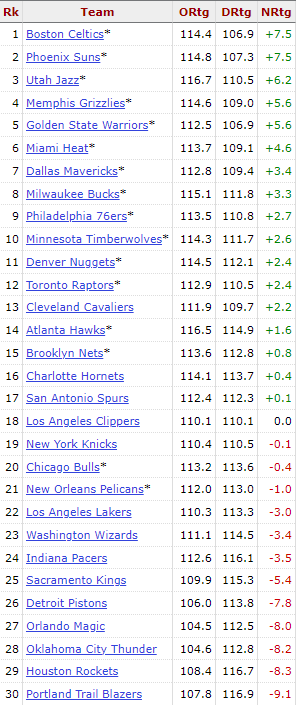

In [172]:
scale = MinMaxScaler()
X_2 = scale.fit_transform(X.astype(float))

In [173]:
X_df = pd.DataFrame(data=X_2, columns=X.columns)
X_df.head()

,FG per game,FGA per game,FG%,3P per game,3PA per game,3P%,2P per game,2PA per game,2P%,FT per game,...,16-3P FG%,3P FG%,2P,3P,Dunks %FGA,Dunks Md.,Layups %FGA,Layups Md.,Corner %3PA,Corner 3P%
0,0.650000,0.656566,0.490909,1.000000,1.000,0.625000,0.302632,0.245283,0.551282,0.652174,...,0.248322,0.625000,0.527950,0.378378,0.566038,0.601351,0.625000,0.614604,0.398374,0.659574
1,0.966667,1.000000,0.563636,0.232558,0.312,0.535714,0.986842,1.000000,0.282051,0.434783,...,0.355705,0.535714,0.434783,0.686486,0.377358,0.449324,0.571429,0.673428,0.471545,0.382979
2,0.683333,0.494949,0.690909,0.837209,0.768,0.767857,0.434211,0.327044,0.602564,0.608696,...,0.442953,0.767857,0.167702,0.335135,0.245283,0.222973,0.383929,0.501014,0.552846,0.648936
3,0.850000,0.696970,0.690909,0.790698,0.752,0.750000,0.565789,0.471698,0.576923,0.173913,...,0.604027,0.750000,0.776398,0.702703,0.811321,0.945946,0.687500,0.624746,0.926829,0.425532
4,1.000000,0.565657,1.000000,0.255814,0.248,0.732143,1.000000,0.779874,0.692308,0.195652,...,0.657718,0.732143,0.732919,0.567568,0.320755,0.402027,0.107143,0.239351,0.707317,0.617021


In [174]:
y = df['Made Playoffs?']
y.head()

0    1
1    1
2    1
3    0
4    1
Name: Made Playoffs?, dtype: int64

## Model Testing

In [175]:
target = df['Made Playoffs?'].to_numpy()
features = df.loc[:, 'FG per game':'Corner 3P%'].to_numpy()

In [176]:
X_train, X_test, y_train, y_test = train_test_split(features, target, test_size=0.25, random_state=0)

print("X_train shape: {}".format(X_train.shape))
print("Y_train shape: {}".format(y_train.shape))

print("X_test shape: {}".format(X_test.shape))
print("Y_test shape: {}".format(y_test.shape))

X_train shape: (22, 59)
Y_train shape: (22,)
X_test shape: (8, 59)
Y_test shape: (8,)


## Feature Importance

['kNN', 0.7333333333333333, 'N_Neighbor = 2', 'NA', 134.23060417175293]
134.23060417175293 seconds
['Logistic (l2)', 0.8375, 'C = 5000', 'FT%', 3.289655923843384]
3.289655923843384 seconds
['Logistic (l1)', 0.7833333333333333, 'C = 5000', 'FT%', 1.6479904651641846]
1.6479904651641846 seconds
['LinearSVM (l2)', 0.85, 'C = 10', 'STL per game', 1.8382346630096436]
1.8382346630096436 seconds
['LinearSVM (l1)', 0.825, 'C = 5000', 'FT%', 5.562322378158569]
5.562322378158569 seconds
['Random Forest', 0.6875, 'Max_features = 0.7', 'TS%', 31.935145378112793]
31.935145378112793 seconds
['Gradient Boosting Method', 0.7416666666666667, 'Max_features = 0.8', 'TS%', 11.603374242782593]
31.935145378112793 seconds


<Figure size 1080x1440 with 0 Axes>

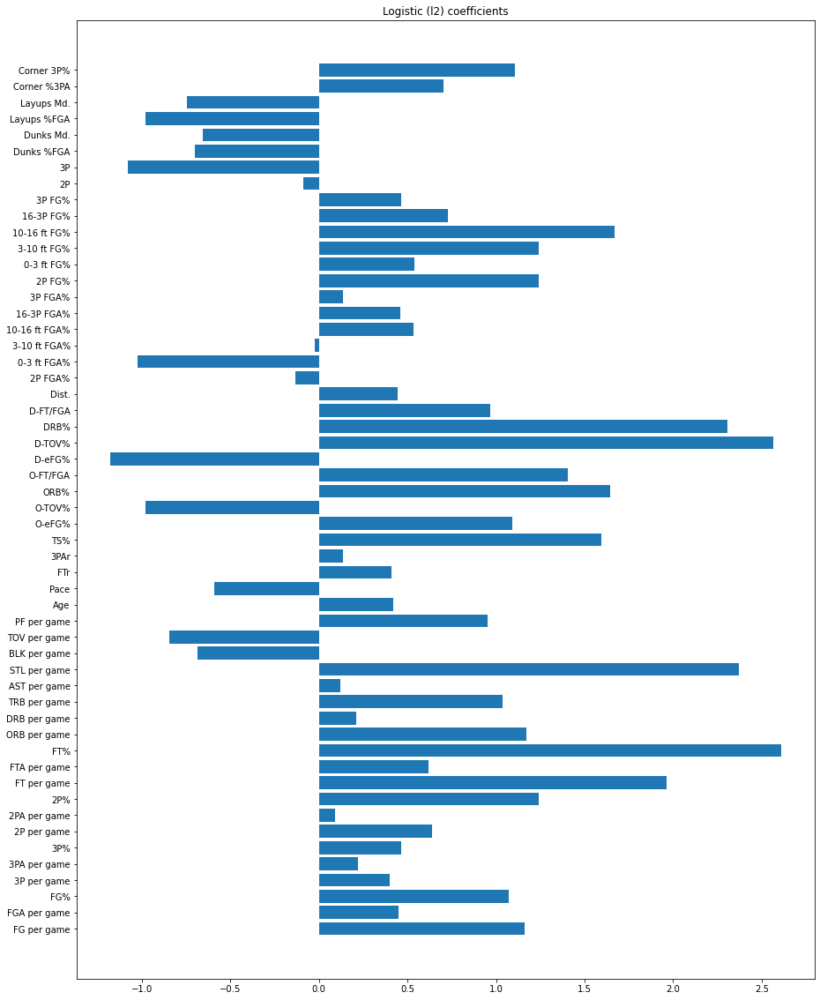

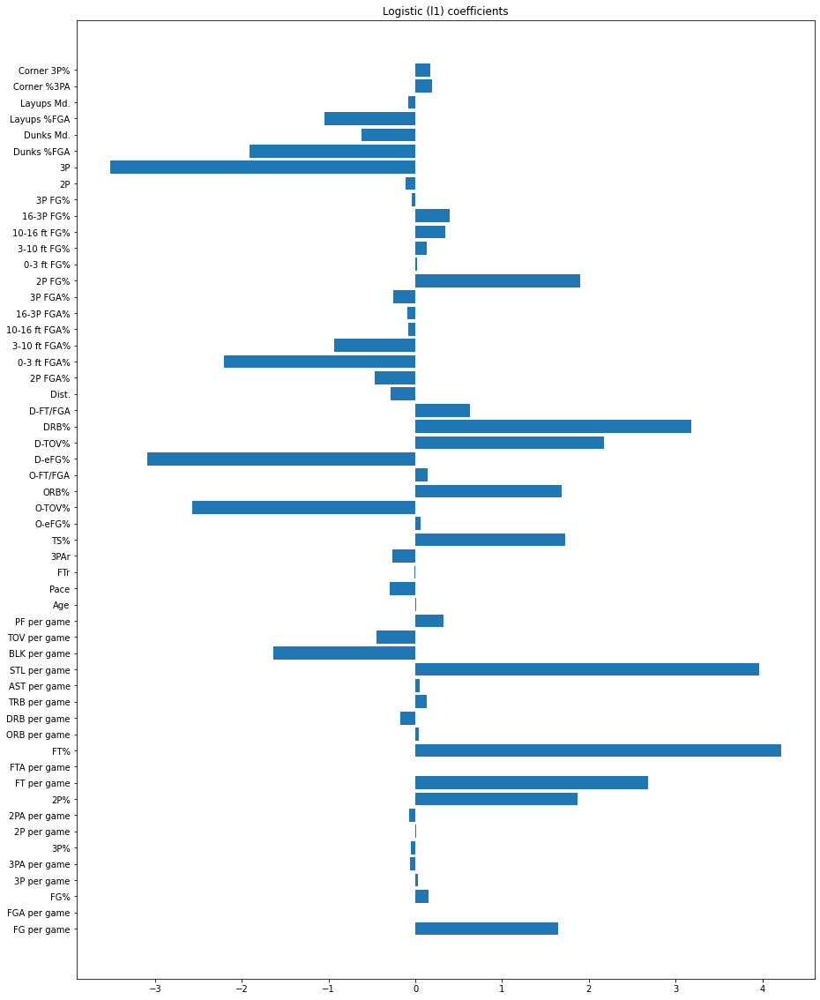

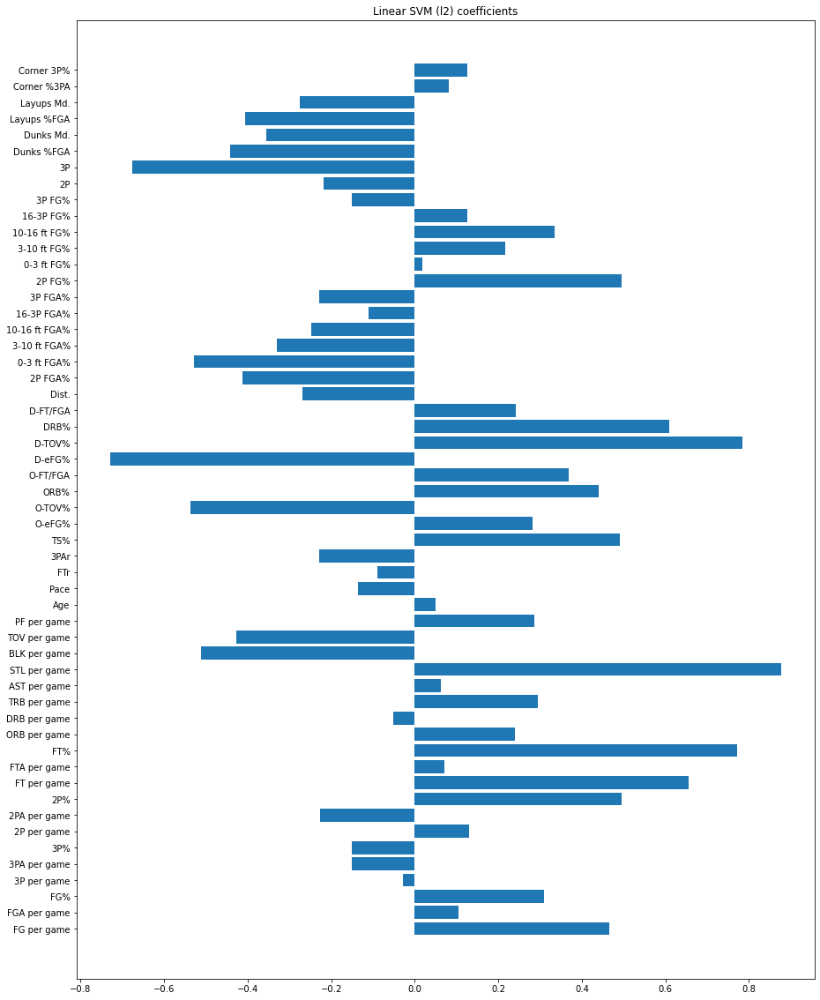

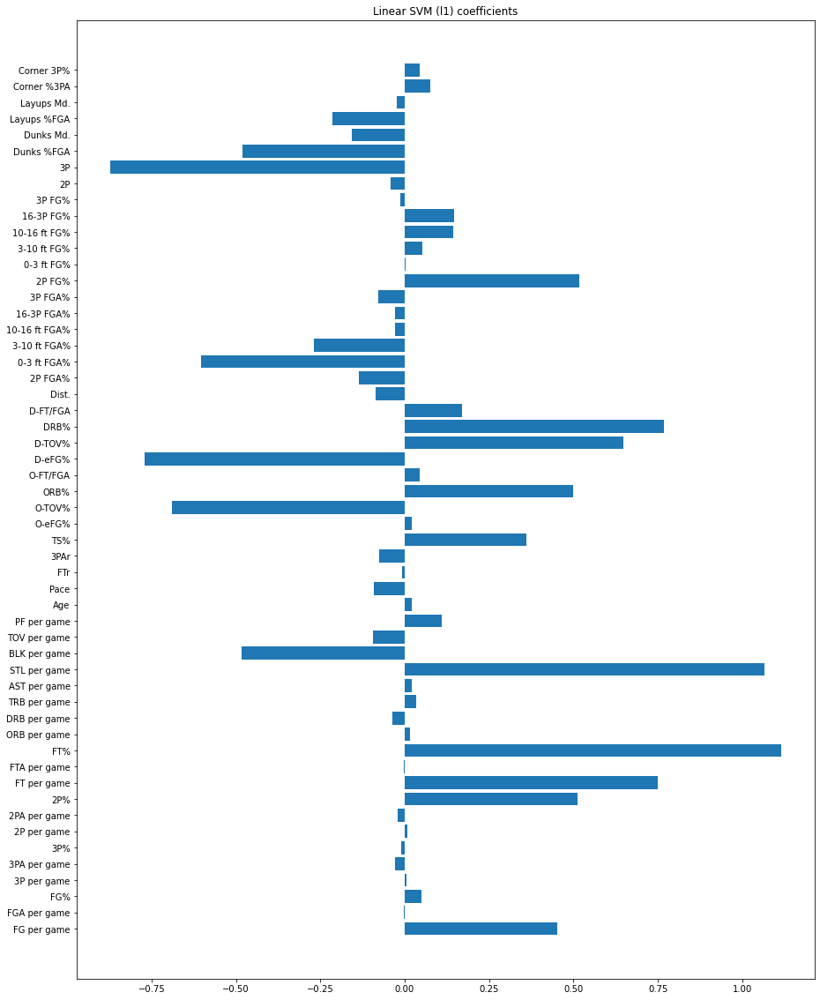

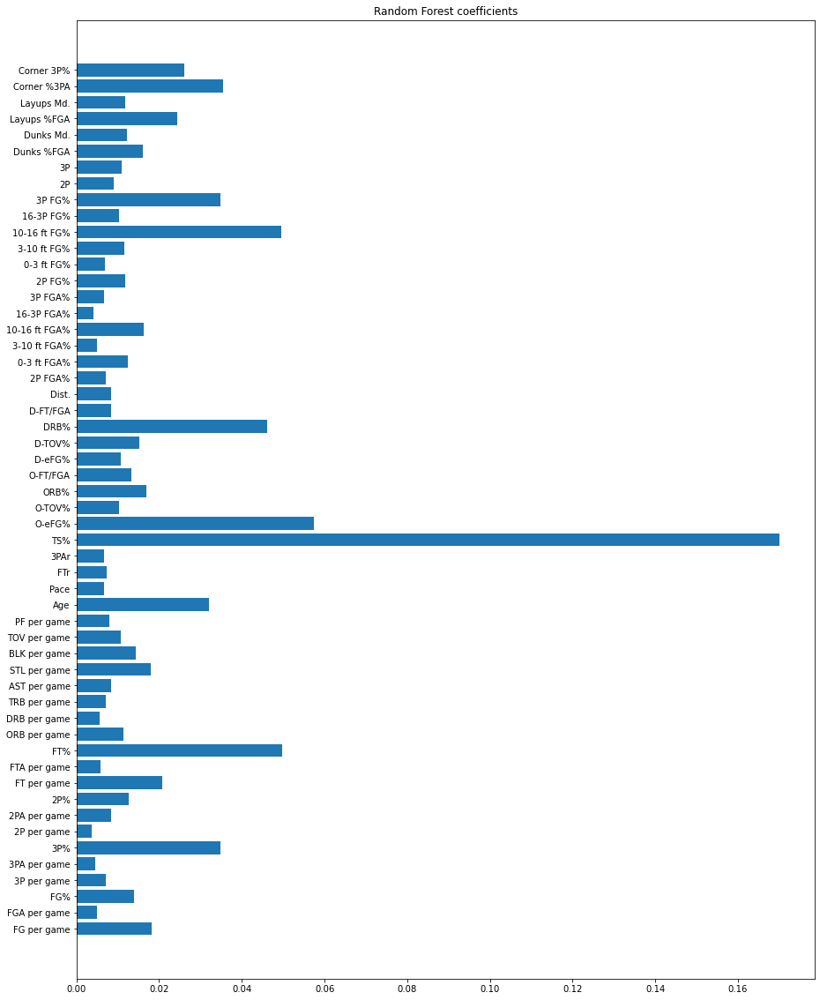

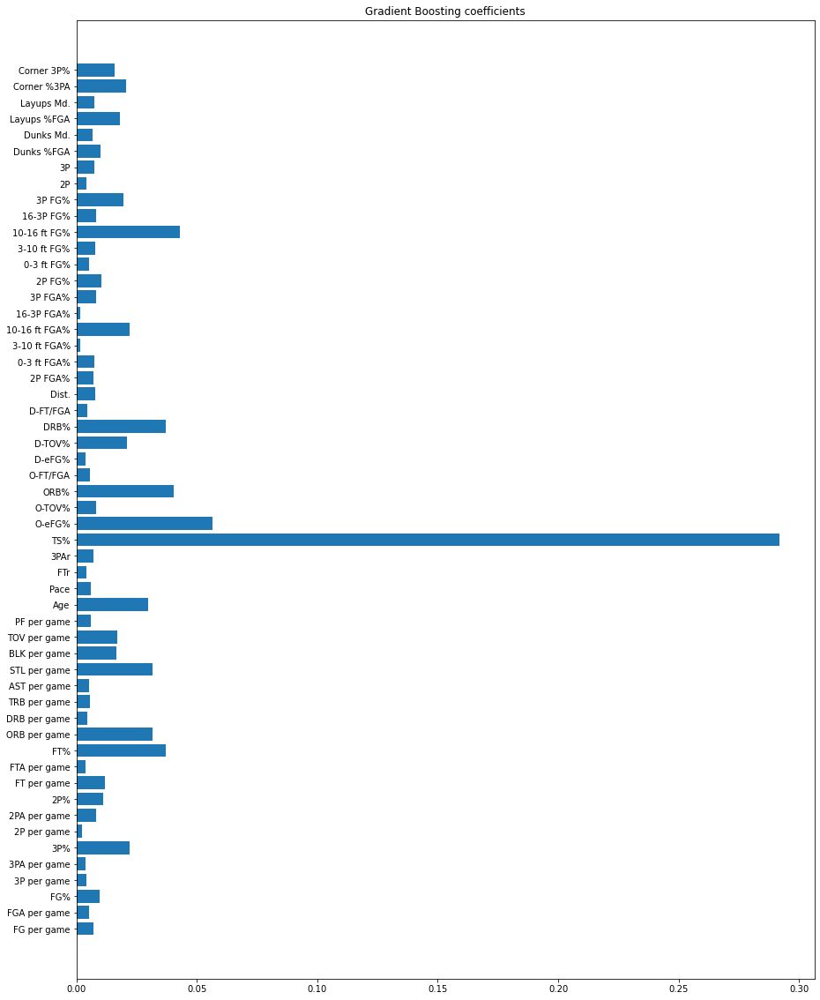

In [177]:
X = X_df

y = y

start_time = time.time()
a = train_knn(X,y)
print(a)
print("%s seconds" % a[4])

start_time = time.time()
b = train_logistic(X,y,reg='l2')
print(b)
print("%s seconds" % b[4])

start_time = time.time()
c = train_logistic(X,y,reg='l1')
print(c)
print("%s seconds" % c[4])

start_time = time.time()
d = train_svm(X,y,reg='l2')
print(d)
print("%s seconds" % d[4])

start_time = time.time()
e = train_svm(X,y,reg='l1')
print(e)
print("%s seconds" % e[4])

start_time = time.time()
f = train_RF(X,y,reg='none')
print(f)
print("%s seconds" % f[4])

start_time = time.time()
g = train_GBM(X,y,reg='none')
print(g)
print("%s seconds" % f[4])

## Test Performance

In [178]:
columns = ['Machine Learning Method', 'Test Accuracy',
        'Best Parameter', 'Top Predictor Variable', 'Run Time']
result = pd.DataFrame(columns=columns)
result.loc[0] = a
result.loc[1] = b
result.loc[2] = c
result.loc[3] = d
result.loc[4] = e
result.loc[5] = f
result.loc[6] = g
result

,Machine Learning Method,Test Accuracy,Best Parameter,Top Predictor Variable,Run Time
0,kNN,0.733333,N_Neighbor = 2,NA,134.230604
1,Logistic (l2),0.837500,C = 5000,FT%,3.289656
2,Logistic (l1),0.783333,C = 5000,FT%,1.647990
3,LinearSVM (l2),0.850000,C = 10,STL per game,1.838235
4,LinearSVM (l1),0.825000,C = 5000,FT%,5.562322
5,Random Forest,0.687500,Max_features = 0.7,TS%,31.935145
6,Gradient Boosting Method,0.741667,Max_features = 0.8,TS%,11.603374


Without points per game, offense and defense rating; free throws, true shooting percentage and steals per game lead. Free throws are the easiest points to make in the game as they're the least contested. They shouldn't be taken for granted. Steals per game each translate to a turnover for the opposing team and can translate to points. True shooting percentage takes into account accuracy of all points involved from two-pointers to three-pointers and free-throws. What this test shows is that efficency and accuracy are king.

## Basic Stats Only

### Data pre-processing

In [179]:
df_basic.isna().sum()

Team              0
G                 0
MP                0
FG                0
FGA               0
FG%               0
3P                0
3PA               0
3P%               0
2P                0
2PA               0
2P%               0
FT                0
FTA               0
FT%               0
ORB               0
DRB               0
TRB               0
AST               0
STL               0
BLK               0
TOV               0
PF                0
PTS               0
Made playoffs?    0
dtype: int64

In [180]:
df_basic.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 30 entries, 1 to 30
Data columns (total 25 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   Team            30 non-null     object 
 1   G               30 non-null     int64  
 2   MP              30 non-null     float64
 3   FG              30 non-null     float64
 4   FGA             30 non-null     float64
 5   FG%             30 non-null     float64
 6   3P              30 non-null     float64
 7   3PA             30 non-null     float64
 8   3P%             30 non-null     float64
 9   2P              30 non-null     float64
 10  2PA             30 non-null     float64
 11  2P%             30 non-null     float64
 12  FT              30 non-null     float64
 13  FTA             30 non-null     float64
 14  FT%             30 non-null     float64
 15  ORB             30 non-null     float64
 16  DRB             30 non-null     float64
 17  TRB             30 non-null     float

In [181]:
X = df_basic.drop(['Team','G','Made playoffs?','MP'], axis=1)
X.head()

,FG,FGA,FG%,3P,3PA,3P%,2P,2PA,2P%,FT,...,FT%,ORB,DRB,TRB,AST,STL,BLK,TOV,PF,PTS
Rk,,,,,,,,,,,,,,,,,,,,,
1,41.6,91.0,0.457,14.8,41.3,0.358,26.8,49.7,0.540,18.0,...,0.778,11.2,32.9,44.2,25.7,8.8,5.6,14.3,21.8,115.9
2,43.5,94.4,0.461,11.5,32.7,0.353,32.0,61.7,0.519,17.0,...,0.734,14.1,35.0,49.2,26.0,9.8,6.5,13.2,19.8,115.6
3,41.8,89.4,0.468,14.1,38.4,0.366,27.8,51.0,0.544,17.8,...,0.776,10.2,36.5,46.7,23.9,7.6,4.0,13.4,18.2,115.5
4,42.8,91.4,0.468,13.9,38.2,0.365,28.8,53.3,0.542,15.8,...,0.740,10.8,33.7,44.6,28.1,8.6,4.9,13.3,19.9,115.3
5,43.7,90.1,0.485,11.6,31.9,0.364,32.1,58.2,0.551,15.9,...,0.797,9.8,35.5,45.3,27.4,8.6,4.4,12.9,19.9,114.8


In [182]:
scale = MinMaxScaler()
X_2 = scale.fit_transform(X.astype(float))

In [183]:
X_df = pd.DataFrame(data=X_2, columns=X.columns)
X_df.head()

,FG,FGA,FG%,3P,3PA,3P%,2P,2PA,2P%,FT,...,FT%,ORB,DRB,TRB,AST,STL,BLK,TOV,PF,PTS
0,0.650000,0.656566,0.490909,1.000000,1.000,0.625000,0.302632,0.245283,0.551282,0.652174,...,0.601852,0.482143,0.200000,0.305556,0.612903,0.705882,0.727273,0.521739,0.977273,1.000000
1,0.966667,1.000000,0.563636,0.232558,0.312,0.535714,0.986842,1.000000,0.282051,0.434783,...,0.194444,1.000000,0.666667,1.000000,0.661290,1.000000,1.000000,0.282609,0.522727,0.975410
2,0.683333,0.494949,0.690909,0.837209,0.768,0.767857,0.434211,0.327044,0.602564,0.608696,...,0.583333,0.303571,1.000000,0.652778,0.322581,0.352941,0.242424,0.326087,0.159091,0.967213
3,0.850000,0.696970,0.690909,0.790698,0.752,0.750000,0.565789,0.471698,0.576923,0.173913,...,0.250000,0.410714,0.377778,0.361111,1.000000,0.647059,0.515152,0.304348,0.545455,0.950820
4,1.000000,0.565657,1.000000,0.255814,0.248,0.732143,1.000000,0.779874,0.692308,0.195652,...,0.777778,0.232143,0.777778,0.458333,0.887097,0.647059,0.363636,0.217391,0.545455,0.909836


In [184]:
y = df_basic['Made playoffs?']
y.head()

Rk
1    1
2    1
3    1
4    0
5    1
Name: Made playoffs?, dtype: int64

## Model Testing

In [185]:
target = df_basic['Made playoffs?'].to_numpy()
features = df_basic.loc[:, 'MP':'PTS'].to_numpy()

In [186]:
X_train, X_test, y_train, y_test = train_test_split(features, target, test_size=0.25, random_state=0)

print("X_train shape: {}".format(X_train.shape))
print("Y_train shape: {}".format(y_train.shape))

print("X_test shape: {}".format(X_test.shape))
print("Y_test shape: {}".format(y_test.shape))

X_train shape: (22, 22)
Y_train shape: (22,)
X_test shape: (8, 22)
Y_test shape: (8,)


## Feature Importance

['kNN', 0.7166666666666667, 'N_Neighbor = 5', 'NA', 119.63002133369446]
119.63002133369446 seconds
['Logistic (l2)', 0.825, 'C = 300', 'FT%', 2.737520933151245]
2.737520933151245 seconds
['Logistic (l1)', 0.775, 'C = 100', 'FT%', 1.4340298175811768]
1.4340298175811768 seconds
['LinearSVM (l2)', 0.8333333333333334, 'C = 3', 'FT%', 1.5259580612182617]
1.5259580612182617 seconds
['LinearSVM (l1)', 0.8, 'C = 5000', 'FT%', 4.447250127792358]
4.447250127792358 seconds
['Random Forest', 0.6166666666666667, 'Max_features = 0.7', 'FT%', 31.185138940811157]
31.185138940811157 seconds
['Gradient Boosting Method', 0.6208333333333333, 'Max_features = 0.2', 'FT%', 11.496053218841553]
31.185138940811157 seconds


<Figure size 1080x1440 with 0 Axes>

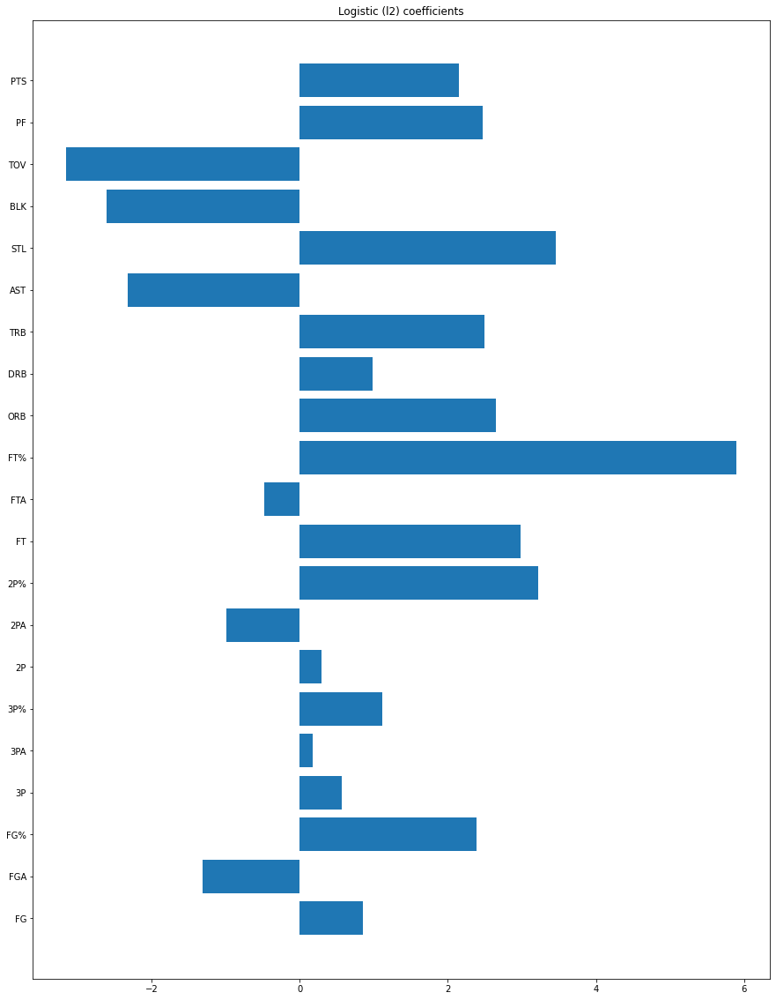

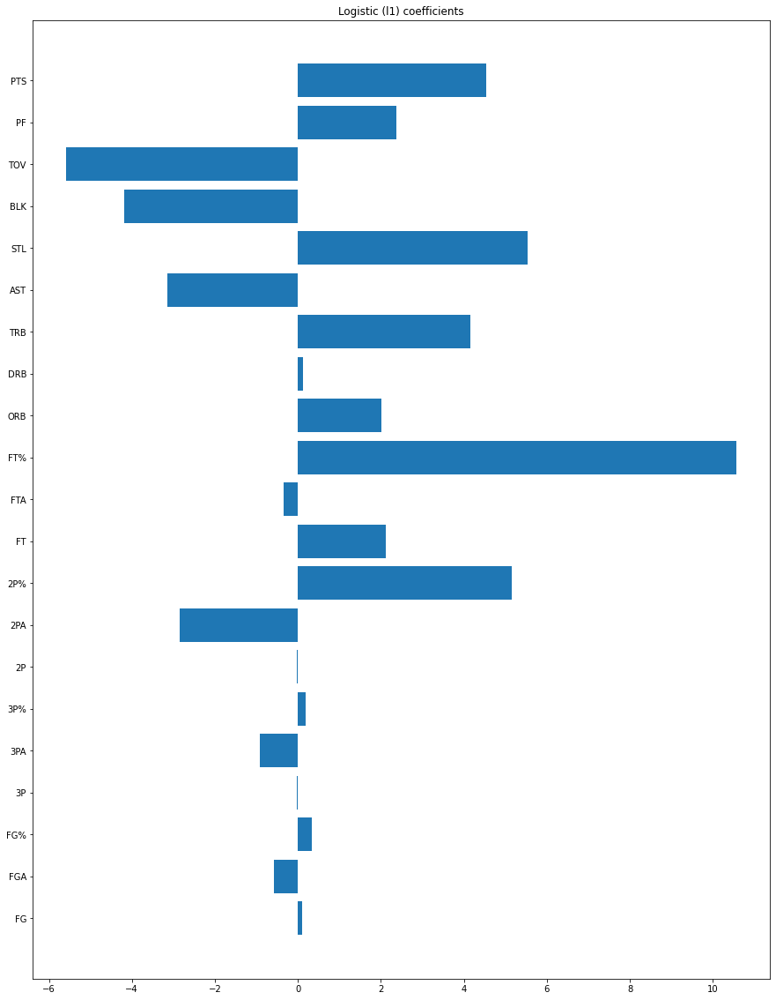

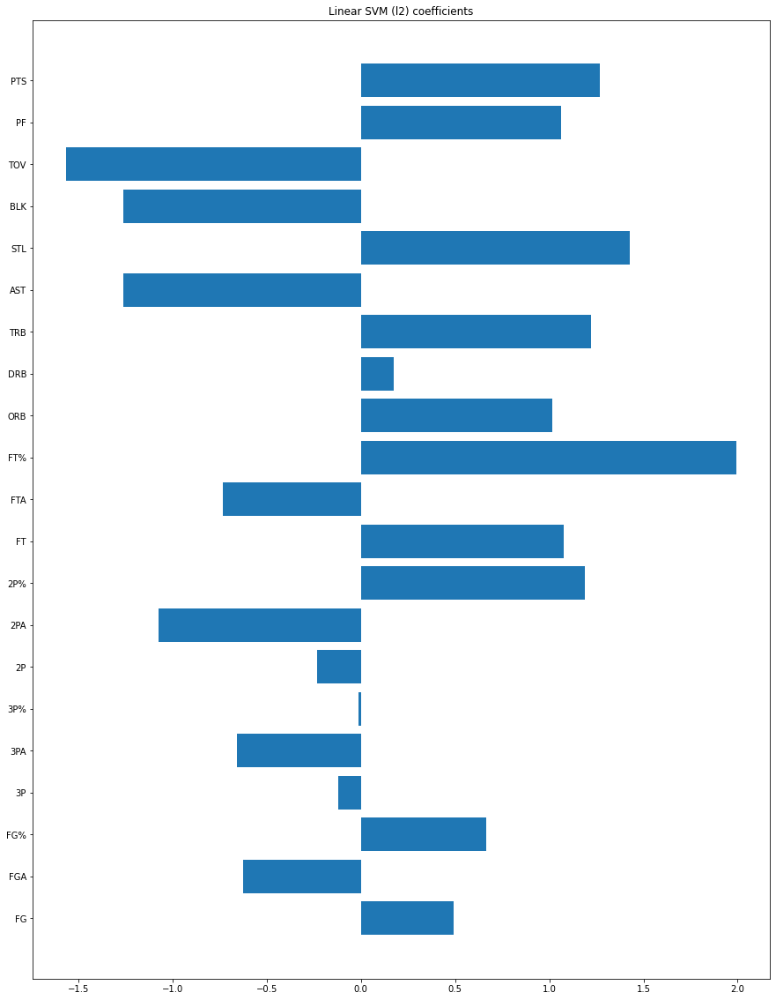

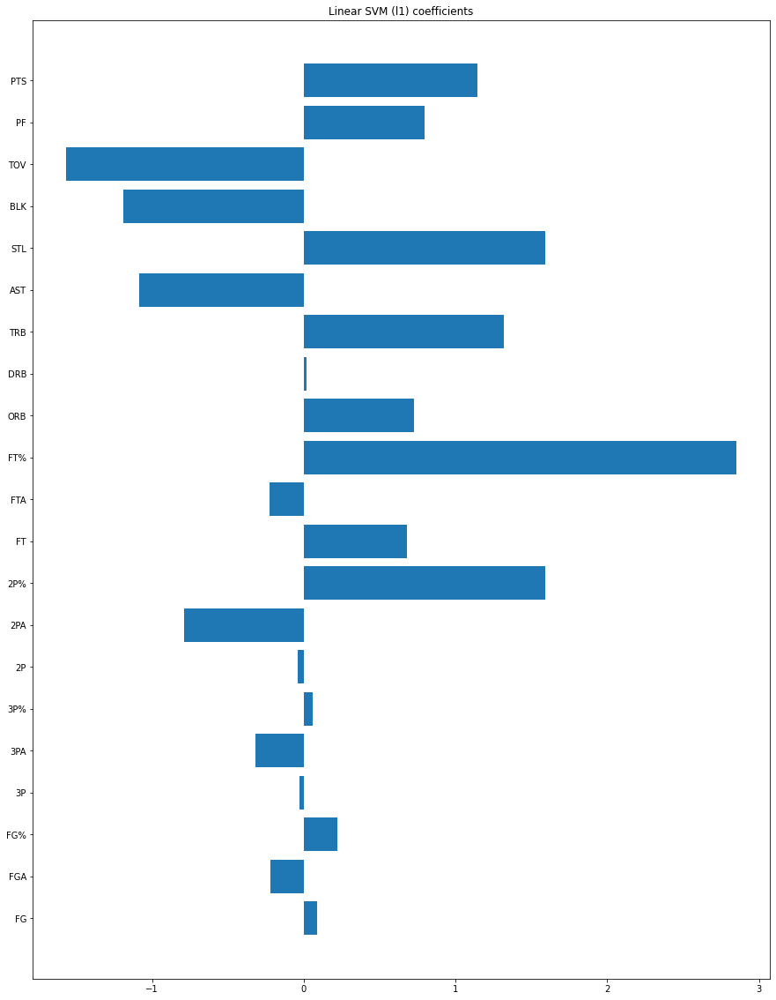

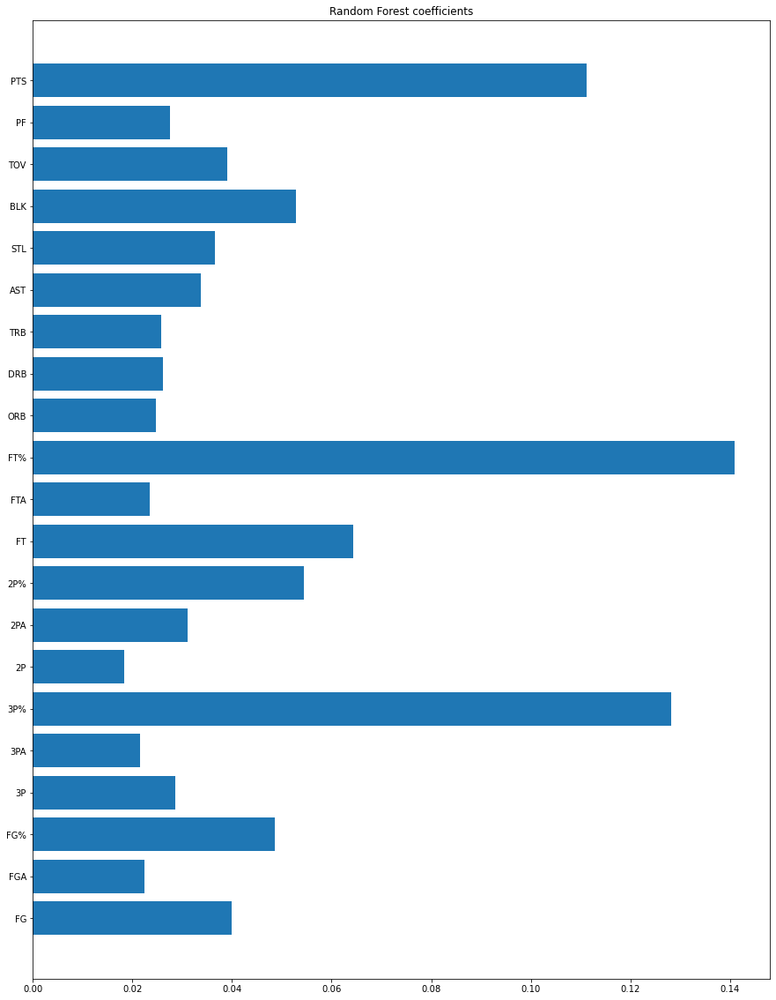

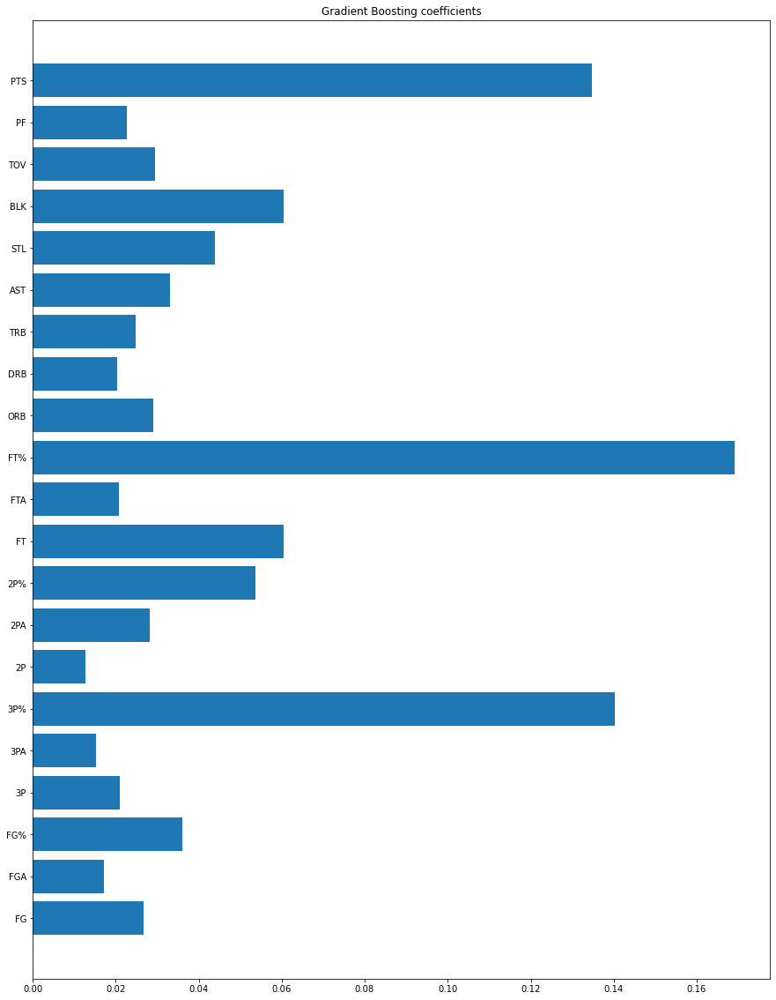

In [187]:
X = X_df

y = y

start_time = time.time()
a = train_knn(X,y)
print(a)
print("%s seconds" % a[4])

start_time = time.time()
b = train_logistic(X,y,reg='l2')
print(b)
print("%s seconds" % b[4])

start_time = time.time()
c = train_logistic(X,y,reg='l1')
print(c)
print("%s seconds" % c[4])

start_time = time.time()
d = train_svm(X,y,reg='l2')
print(d)
print("%s seconds" % d[4])

start_time = time.time()
e = train_svm(X,y,reg='l1')
print(e)
print("%s seconds" % e[4])

start_time = time.time()
f = train_RF(X,y,reg='none')
print(f)
print("%s seconds" % f[4])

start_time = time.time()
g = train_GBM(X,y,reg='none')
print(g)
print("%s seconds" % f[4])

## Test Performance

In [188]:
columns = ['Machine Learning Method', 'Test Accuracy',
        'Best Parameter', 'Top Predictor Variable', 'Run Time']
result = pd.DataFrame(columns=columns)
result.loc[0] = a
result.loc[1] = b
result.loc[2] = c
result.loc[3] = d
result.loc[4] = e
result.loc[5] = f
result.loc[6] = g
result

,Machine Learning Method,Test Accuracy,Best Parameter,Top Predictor Variable,Run Time
0,kNN,0.716667,N_Neighbor = 5,NA,119.630021
1,Logistic (l2),0.825000,C = 300,FT%,2.737521
2,Logistic (l1),0.775000,C = 100,FT%,1.434030
3,LinearSVM (l2),0.833333,C = 3,FT%,1.525958
4,LinearSVM (l1),0.800000,C = 5000,FT%,4.447250
5,Random Forest,0.616667,Max_features = 0.7,FT%,31.185139
6,Gradient Boosting Method,0.620833,Max_features = 0.2,FT%,11.496053


Even basic stats model testing show its importance - free throws anyway are the easiest points to make in the game after all. Scouts are also known to use free throw shooting as a strong indicator for shooting, and while this doesn't quite show collinearity according to the pair plots, what free throw shooting means to scouts is a way for them to check whether or not a player has shooting form and touch that can translate well to the next level. This makes sense as it is noticeably true that efficient volume distance shooters tend to be efficient free throw shooters as well. It should be noted that the top 50 NBA players today in three-point attempts have an average free throw accuracy of over 81%, while league average is 78%.

## Advanced stats only

### Data pre-processing

In [189]:
df_advanced.isna().sum()

Team              0
Age               0
W                 0
L                 0
ORtg              0
DRtg              0
Pace              0
FTr               0
3PAr              0
TS%               0
O-eFG%            0
O-TOV%            0
ORB%              0
O-FT/FGA          0
D-eFG%            0
D-TOV%            0
DRB%              0
D-FT/FGA          0
Made playoffs?    0
dtype: int64

In [190]:
df_advanced.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 30 entries, 1 to 30
Data columns (total 19 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   Team            30 non-null     object 
 1   Age             30 non-null     float64
 2   W               30 non-null     int64  
 3   L               30 non-null     int64  
 4   ORtg            30 non-null     float64
 5   DRtg            30 non-null     float64
 6   Pace            30 non-null     float64
 7   FTr             30 non-null     float64
 8   3PAr            30 non-null     float64
 9   TS%             30 non-null     float64
 10  O-eFG%          30 non-null     float64
 11  O-TOV%          30 non-null     float64
 12  ORB%            30 non-null     float64
 13  O-FT/FGA        30 non-null     float64
 14  D-eFG%          30 non-null     float64
 15  D-TOV%          30 non-null     float64
 16  DRB%            30 non-null     float64
 17  D-FT/FGA        30 non-null     float

In [191]:
X = df_advanced.drop(['Team','Made playoffs?','W','L'], axis=1)
X.head()

,Age,ORtg,DRtg,Pace,FTr,3PAr,TS%,O-eFG%,O-TOV%,ORB%,O-FT/FGA,D-eFG%,D-TOV%,DRB%,D-FT/FGA
Rk,,,,,,,,,,,,,,,
1,26.1,114.4,106.9,96.6,0.239,0.425,0.578,0.542,12.4,24.0,0.195,0.502,12.5,77.3,0.183
2,27.5,114.8,107.3,99.8,0.221,0.354,0.581,0.549,11.6,22.3,0.176,0.510,13.0,77.1,0.195
3,29.3,116.7,110.5,97.1,0.271,0.468,0.589,0.555,12.7,25.4,0.208,0.521,10.9,78.3,0.164
4,24.0,114.6,109.0,100.3,0.245,0.346,0.553,0.522,11.2,30.0,0.180,0.523,13.3,77.8,0.195
5,27.6,112.5,106.9,98.4,0.235,0.456,0.582,0.552,13.5,22.8,0.181,0.509,13.0,78.7,0.201


In [192]:
scale = MinMaxScaler()
X_2 = scale.fit_transform(X.astype(float))

In [193]:
X_df = pd.DataFrame(data=X_2, columns=X.columns)
X_df.head()

,Age,ORtg,DRtg,Pace,FTr,3PAr,TS%,O-eFG%,O-TOV%,ORB%,O-FT/FGA,D-eFG%,D-TOV%,DRB%,D-FT/FGA
0,0.474359,0.811475,0.00,0.218182,0.296875,0.683824,0.800000,0.774194,0.432432,0.411765,0.439394,0.000000,0.486486,0.659091,0.301587
1,0.653846,0.844262,0.04,0.800000,0.015625,0.161765,0.850000,0.887097,0.216216,0.245098,0.151515,0.140351,0.621622,0.613636,0.492063
2,0.884615,1.000000,0.36,0.309091,0.796875,1.000000,0.983333,0.983871,0.513514,0.549020,0.636364,0.333333,0.054054,0.886364,0.000000
3,0.205128,0.827869,0.21,0.890909,0.390625,0.102941,0.383333,0.451613,0.108108,1.000000,0.212121,0.368421,0.702703,0.772727,0.492063
4,0.666667,0.655738,0.00,0.545455,0.234375,0.911765,0.866667,0.935484,0.729730,0.294118,0.227273,0.122807,0.621622,0.977273,0.587302


In [194]:
y = df_advanced['Made playoffs?']
y.head()

Rk
1    1
2    1
3    1
4    1
5    1
Name: Made playoffs?, dtype: int64

## Model Testing

In [195]:
target = df_advanced['Made playoffs?'].to_numpy()
features = df_advanced.drop(['Team','Made playoffs?','W','L'], axis=1).to_numpy()

In [196]:
X_train, X_test, y_train, y_test = train_test_split(features, target, test_size=0.25, random_state=0)

print("X_train shape: {}".format(X_train.shape))
print("Y_train shape: {}".format(y_train.shape))

print("X_test shape: {}".format(X_test.shape))
print("Y_test shape: {}".format(y_test.shape))

X_train shape: (22, 15)
Y_train shape: (22,)
X_test shape: (8, 15)
Y_test shape: (8,)


## Feature Importance

['kNN', 0.775, 'N_Neighbor = 11', 'NA', 68.79131054878235]
68.79131054878235 seconds
['Logistic (l2)', 0.8125, 'C = 1000', 'ORtg', 2.645218849182129]
2.645218849182129 seconds
['Logistic (l1)', 0.775, 'C = 15', 'ORtg', 1.3989148139953613]
1.3989148139953613 seconds
['LinearSVM (l2)', 0.8125, 'C = 100', 'ORtg', 1.3872239589691162]
1.3872239589691162 seconds
['LinearSVM (l1)', 0.775, 'C = 5', 'ORtg', 3.2500832080841064]
3.2500832080841064 seconds
['Random Forest', 0.8541666666666666, 'Max_features = 0.7', 'ORtg', 30.893874406814575]
30.893874406814575 seconds
['Gradient Boosting Method', 0.8208333333333333, 'Max_features = 0.3', 'ORtg', 10.441808462142944]
30.893874406814575 seconds


<Figure size 1080x1440 with 0 Axes>

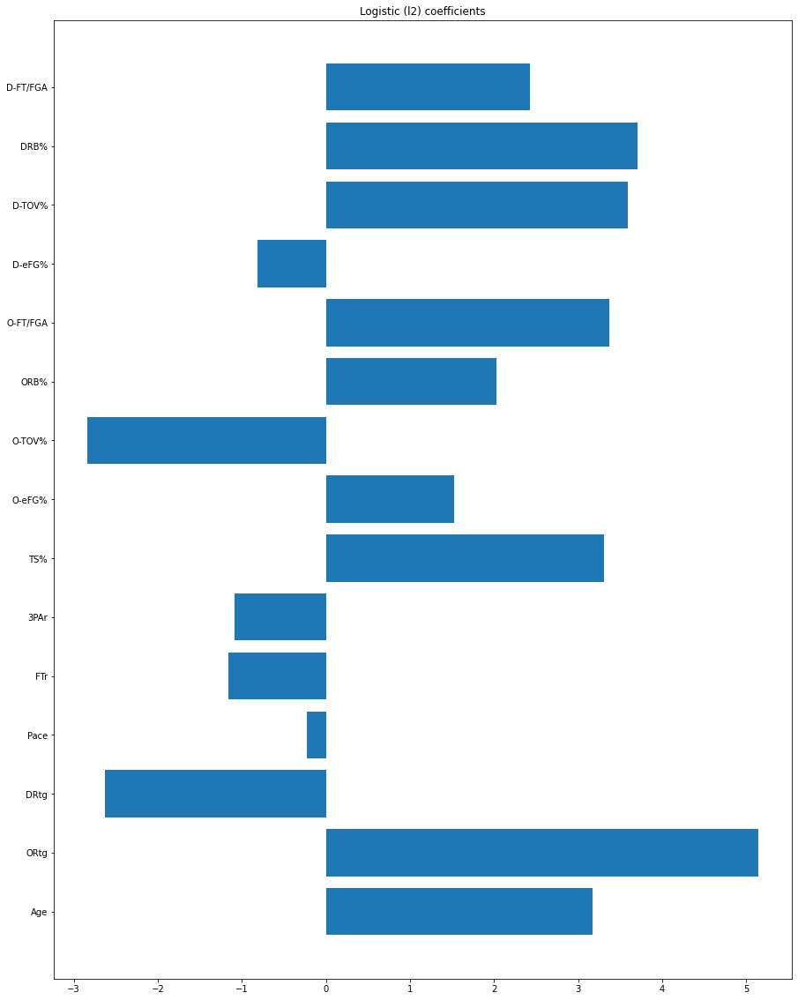

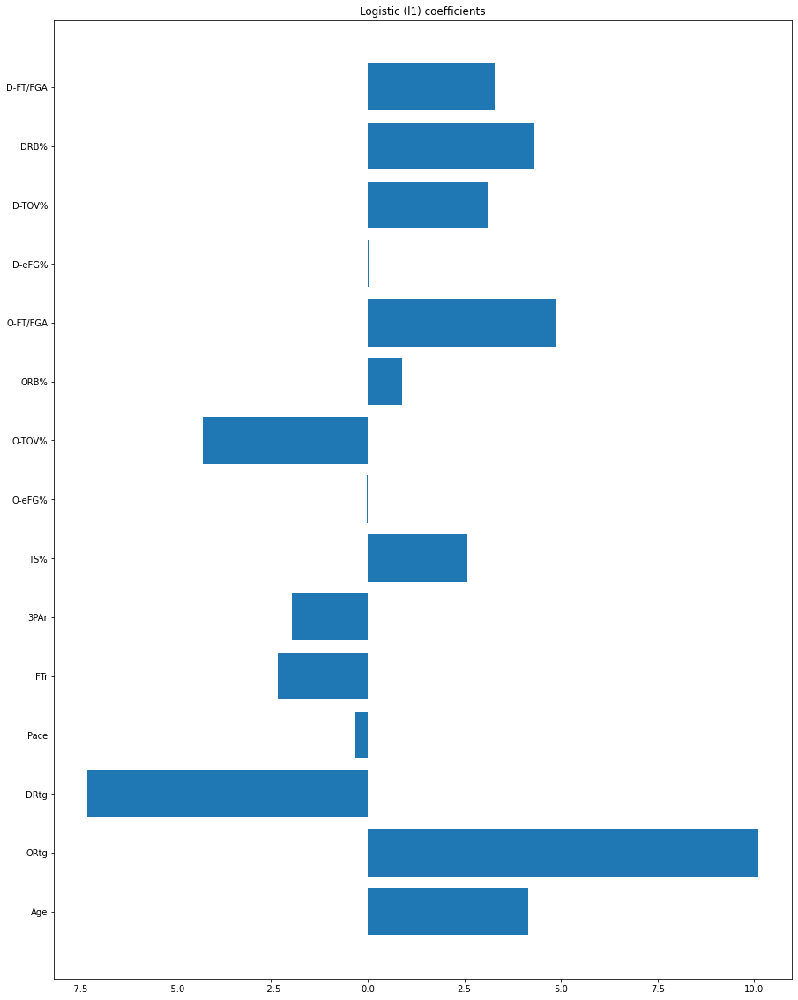

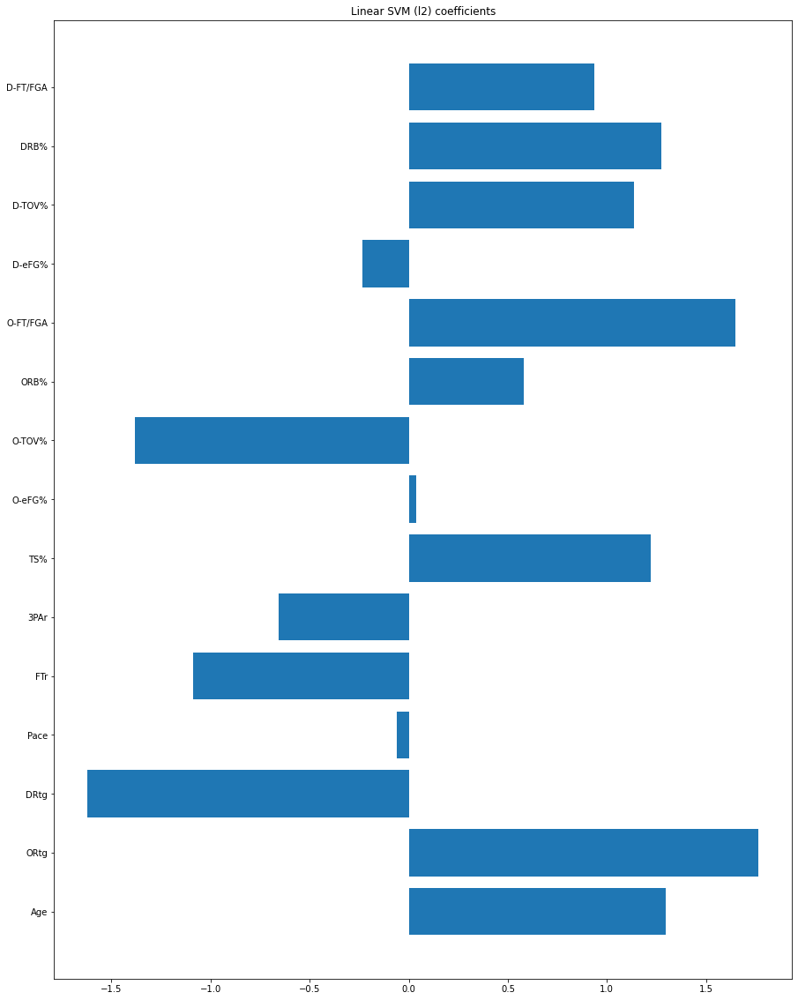

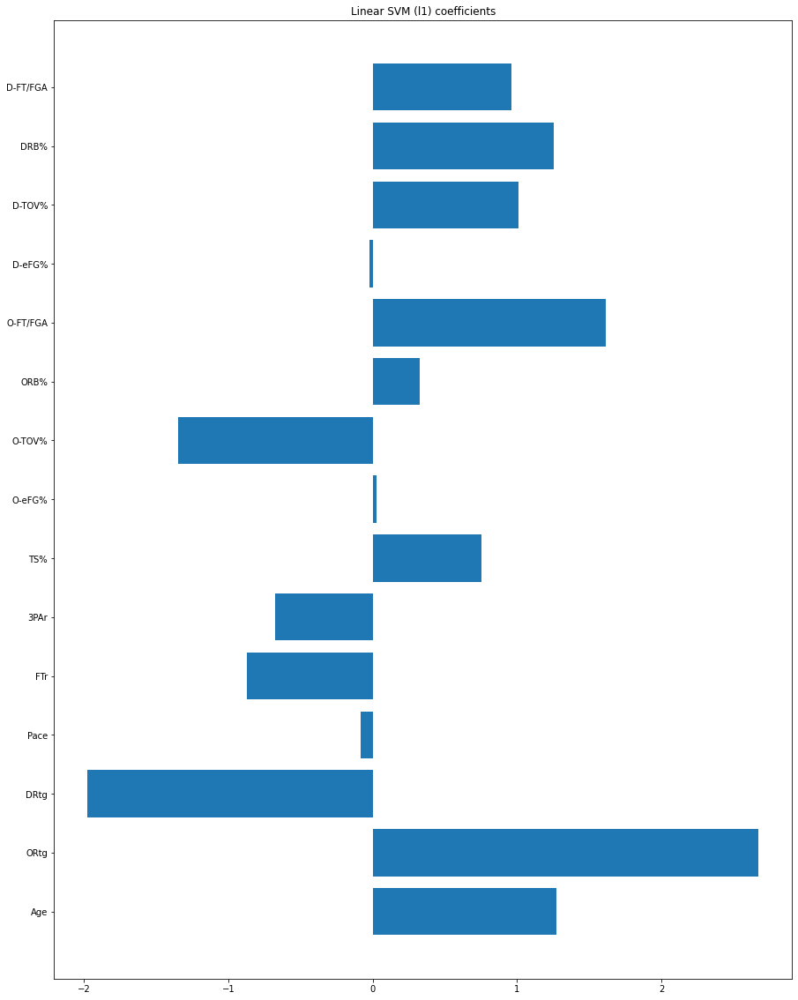

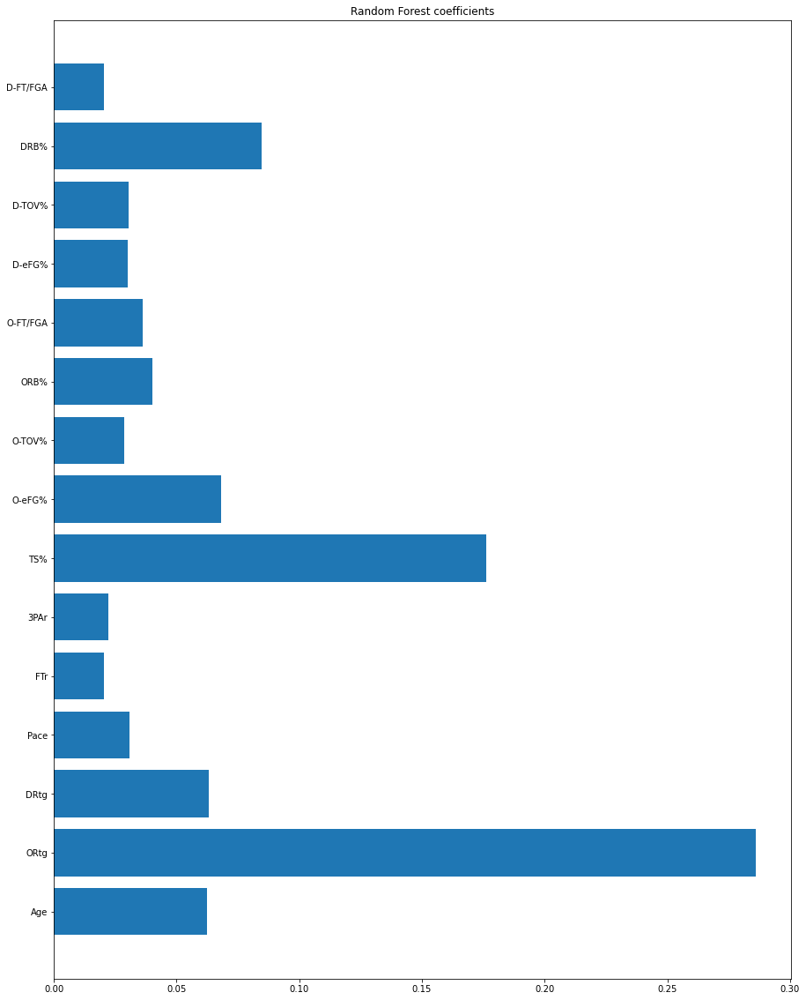

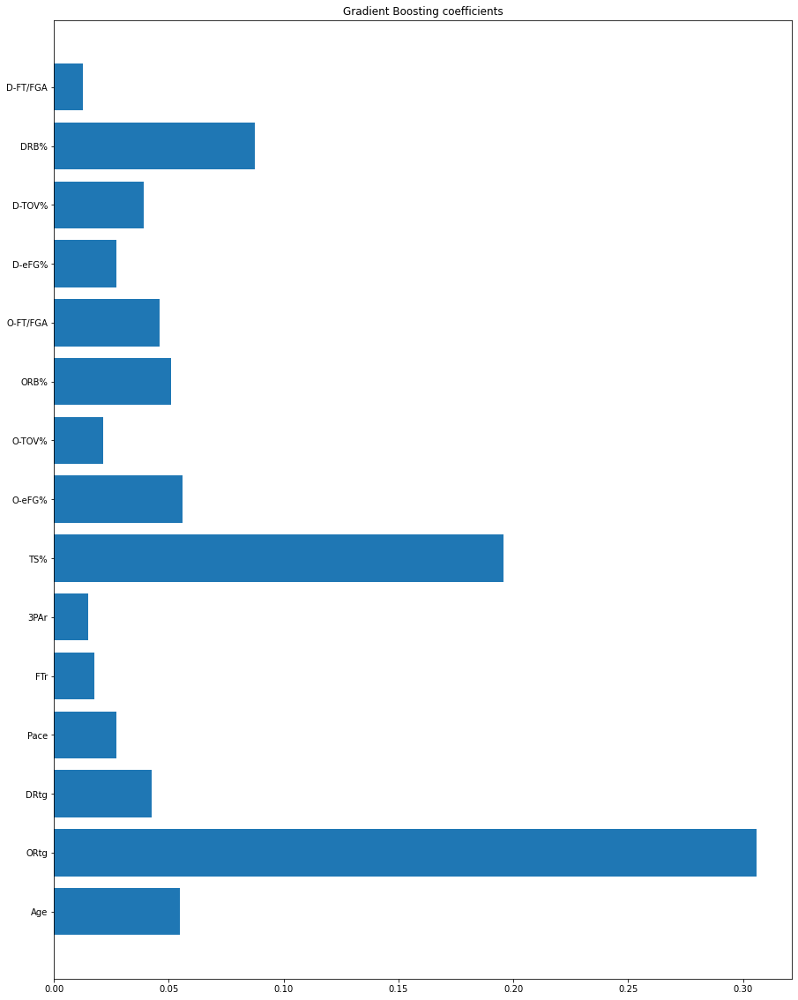

In [197]:
X = X_df

y = y

start_time = time.time()
a = train_knn(X,y)
print(a)
print("%s seconds" % a[4])

start_time = time.time()
b = train_logistic(X,y,reg='l2')
print(b)
print("%s seconds" % b[4])

start_time = time.time()
c = train_logistic(X,y,reg='l1')
print(c)
print("%s seconds" % c[4])

start_time = time.time()
d = train_svm(X,y,reg='l2')
print(d)
print("%s seconds" % d[4])

start_time = time.time()
e = train_svm(X,y,reg='l1')
print(e)
print("%s seconds" % e[4])

start_time = time.time()
f = train_RF(X,y,reg='none')
print(f)
print("%s seconds" % f[4])

start_time = time.time()
g = train_GBM(X,y,reg='none')
print(g)
print("%s seconds" % f[4])

## Test Performance

In [198]:
columns = ['Machine Learning Method', 'Test Accuracy',
        'Best Parameter', 'Top Predictor Variable', 'Run Time']
result = pd.DataFrame(columns=columns)
result.loc[0] = a
result.loc[1] = b
result.loc[2] = c
result.loc[3] = d
result.loc[4] = e
result.loc[5] = f
result.loc[6] = g
result

,Machine Learning Method,Test Accuracy,Best Parameter,Top Predictor Variable,Run Time
0,kNN,0.775000,N_Neighbor = 11,NA,68.791311
1,Logistic (l2),0.812500,C = 1000,ORtg,2.645219
2,Logistic (l1),0.775000,C = 15,ORtg,1.398915
3,LinearSVM (l2),0.812500,C = 100,ORtg,1.387224
4,LinearSVM (l1),0.775000,C = 5,ORtg,3.250083
5,Random Forest,0.854167,Max_features = 0.7,ORtg,30.893874
6,Gradient Boosting Method,0.820833,Max_features = 0.3,ORtg,10.441808


<i>“What these young bloods have to understand is that this game has always been and will always be about buckets.”</i>
This is a quote from the legendary Bill Russell, a fabled defensive leader and mastermind, who himself knows that defense at best leverages your team's offense over an opponent's by hampering theirs.

In testing only advanced stats, offensive rating swept all top predictor variable spots despite defensive rating narrowly takes precedence when all stats are accounted for. An explanation for this may be that it has something to do with the optimization of weights of the algorithm, since it would likely change if you choose a different set/subset of features.

## Advanced stats without ORtg and DRtg

Since we know how apparent the relationship of these two stats are with regular season success.

### Data pre-processing

In [199]:
X = df_advanced.drop(['Team','Made playoffs?','W','L','ORtg','DRtg'], axis=1)
X.head()

,Age,Pace,FTr,3PAr,TS%,O-eFG%,O-TOV%,ORB%,O-FT/FGA,D-eFG%,D-TOV%,DRB%,D-FT/FGA
Rk,,,,,,,,,,,,,
1,26.1,96.6,0.239,0.425,0.578,0.542,12.4,24.0,0.195,0.502,12.5,77.3,0.183
2,27.5,99.8,0.221,0.354,0.581,0.549,11.6,22.3,0.176,0.510,13.0,77.1,0.195
3,29.3,97.1,0.271,0.468,0.589,0.555,12.7,25.4,0.208,0.521,10.9,78.3,0.164
4,24.0,100.3,0.245,0.346,0.553,0.522,11.2,30.0,0.180,0.523,13.3,77.8,0.195
5,27.6,98.4,0.235,0.456,0.582,0.552,13.5,22.8,0.181,0.509,13.0,78.7,0.201


In [200]:
scale = MinMaxScaler()
X_2 = scale.fit_transform(X.astype(float))

In [201]:
X_df = pd.DataFrame(data=X_2, columns=X.columns)
X_df.head()

,Age,Pace,FTr,3PAr,TS%,O-eFG%,O-TOV%,ORB%,O-FT/FGA,D-eFG%,D-TOV%,DRB%,D-FT/FGA
0,0.474359,0.218182,0.296875,0.683824,0.800000,0.774194,0.432432,0.411765,0.439394,0.000000,0.486486,0.659091,0.301587
1,0.653846,0.800000,0.015625,0.161765,0.850000,0.887097,0.216216,0.245098,0.151515,0.140351,0.621622,0.613636,0.492063
2,0.884615,0.309091,0.796875,1.000000,0.983333,0.983871,0.513514,0.549020,0.636364,0.333333,0.054054,0.886364,0.000000
3,0.205128,0.890909,0.390625,0.102941,0.383333,0.451613,0.108108,1.000000,0.212121,0.368421,0.702703,0.772727,0.492063
4,0.666667,0.545455,0.234375,0.911765,0.866667,0.935484,0.729730,0.294118,0.227273,0.122807,0.621622,0.977273,0.587302


In [202]:
y = df_advanced['Made playoffs?']
y.head()

Rk
1    1
2    1
3    1
4    1
5    1
Name: Made playoffs?, dtype: int64

## Model Testing

In [203]:
target = df_advanced['Made playoffs?'].to_numpy()
features = df_advanced.drop(['Team','Made playoffs?','W','L'], axis=1).to_numpy()

In [204]:
X_train, X_test, y_train, y_test = train_test_split(features, target, test_size=0.25, random_state=0)

print("X_train shape: {}".format(X_train.shape))
print("Y_train shape: {}".format(y_train.shape))

print("X_test shape: {}".format(X_test.shape))
print("Y_test shape: {}".format(y_test.shape))

X_train shape: (22, 15)
Y_train shape: (22,)
X_test shape: (8, 15)
Y_test shape: (8,)


## Feature Importance

['kNN', 0.725, 'N_Neighbor = 9', 'NA', 70.12732291221619]
70.12732291221619 seconds
['Logistic (l2)', 0.7875, 'C = 5000', 'TS%', 2.7863845825195312]
2.7863845825195312 seconds
['Logistic (l1)', 0.7458333333333333, 'C = 10', 'TS%', 1.4425048828125]
1.4425048828125 seconds
['LinearSVM (l2)', 0.8041666666666667, 'C = 10', 'O-FT/FGA', 1.524249792098999]
1.524249792098999 seconds
['LinearSVM (l1)', 0.7583333333333333, 'C = 1.5', 'TS%', 3.023955821990967]
3.023955821990967 seconds
['Random Forest', 0.7291666666666666, 'Max_features = 0.3', 'TS%', 34.59739685058594]
34.59739685058594 seconds
['Gradient Boosting Method', 0.7458333333333333, 'Max_features = 0.3', 'TS%', 12.571305751800537]
34.59739685058594 seconds


<Figure size 1080x1440 with 0 Axes>

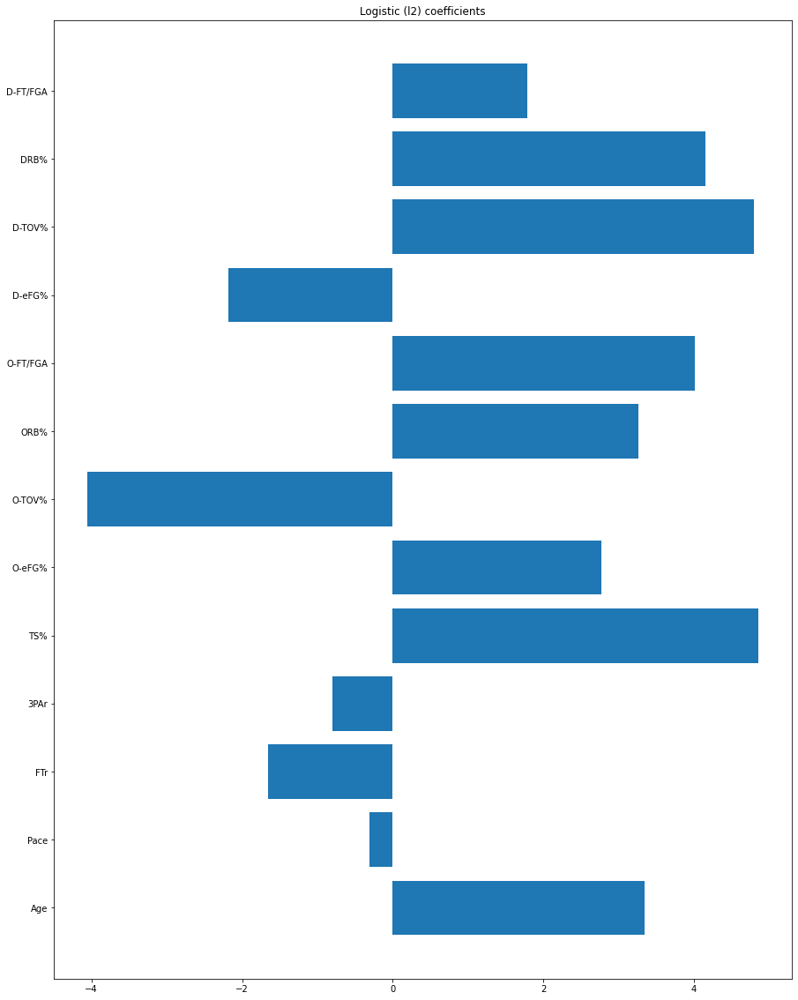

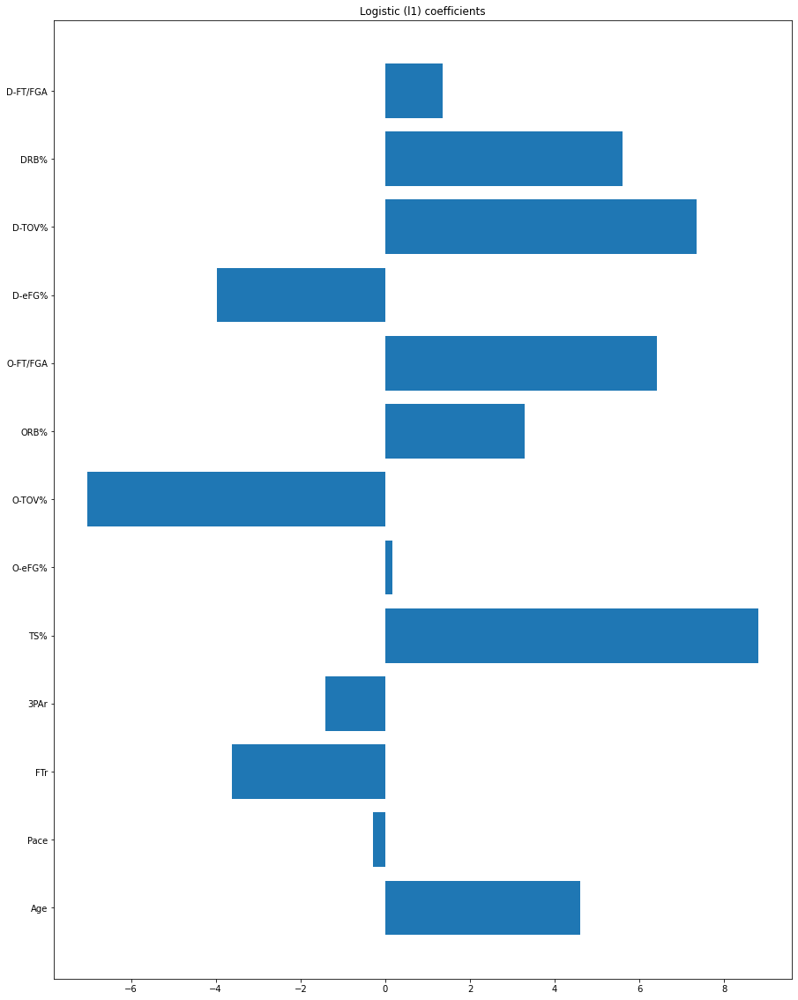

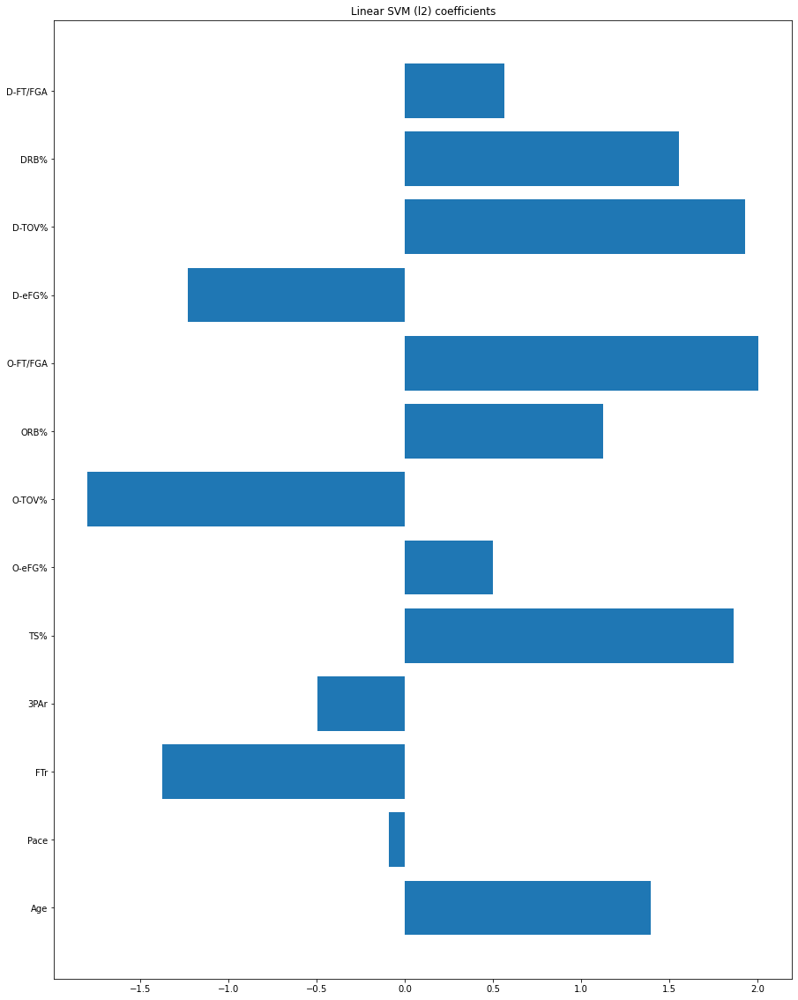

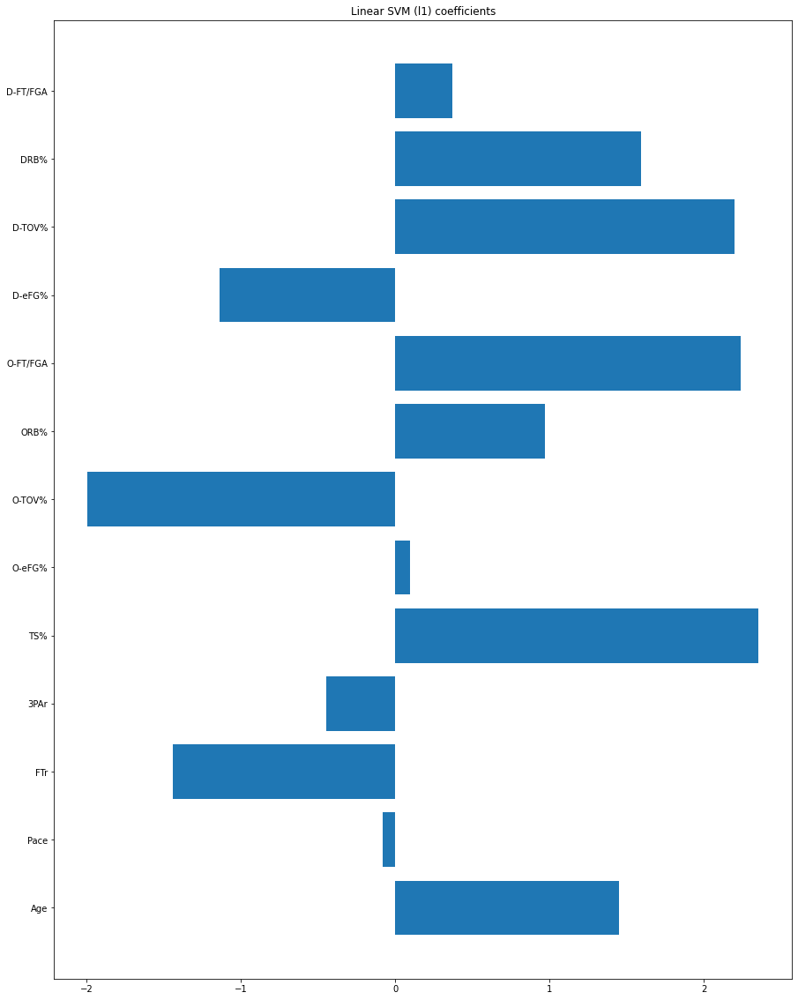

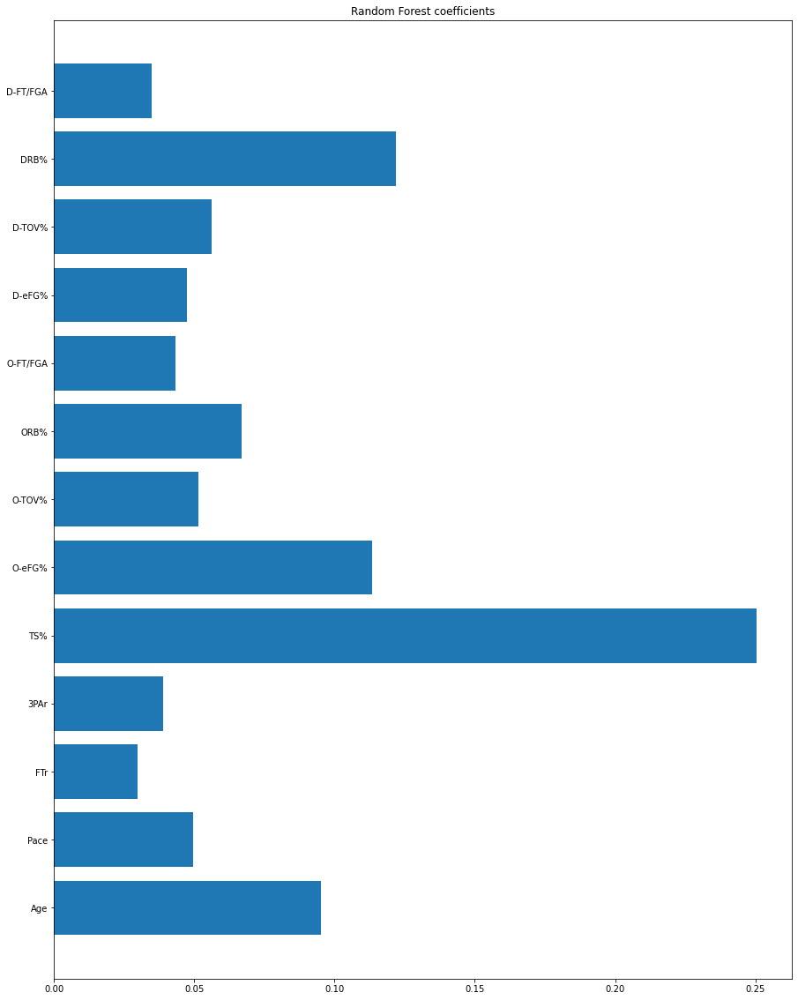

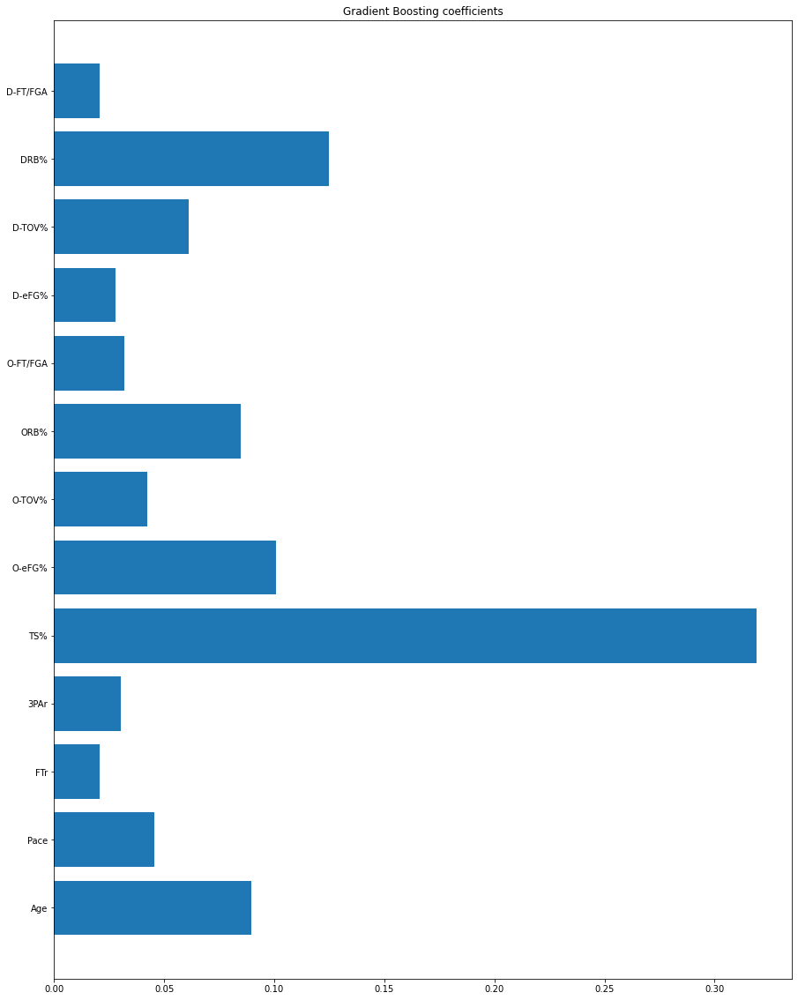

In [205]:
X = X_df

y = y

start_time = time.time()
a = train_knn(X,y)
print(a)
print("%s seconds" % a[4])

start_time = time.time()
b = train_logistic(X,y,reg='l2')
print(b)
print("%s seconds" % b[4])

start_time = time.time()
c = train_logistic(X,y,reg='l1')
print(c)
print("%s seconds" % c[4])

start_time = time.time()
d = train_svm(X,y,reg='l2')
print(d)
print("%s seconds" % d[4])

start_time = time.time()
e = train_svm(X,y,reg='l1')
print(e)
print("%s seconds" % e[4])

start_time = time.time()
f = train_RF(X,y,reg='none')
print(f)
print("%s seconds" % f[4])

start_time = time.time()
g = train_GBM(X,y,reg='none')
print(g)
print("%s seconds" % f[4])

## Test Performance

In [206]:
columns = ['Machine Learning Method', 'Test Accuracy',
        'Best Parameter', 'Top Predictor Variable', 'Run Time']
result = pd.DataFrame(columns=columns)
result.loc[0] = a
result.loc[1] = b
result.loc[2] = c
result.loc[3] = d
result.loc[4] = e
result.loc[5] = f
result.loc[6] = g
result

,Machine Learning Method,Test Accuracy,Best Parameter,Top Predictor Variable,Run Time
0,kNN,0.725000,N_Neighbor = 9,NA,70.127323
1,Logistic (l2),0.787500,C = 5000,TS%,2.786385
2,Logistic (l1),0.745833,C = 10,TS%,1.442505
3,LinearSVM (l2),0.804167,C = 10,O-FT/FGA,1.524250
4,LinearSVM (l1),0.758333,C = 1.5,TS%,3.023956
5,Random Forest,0.729167,Max_features = 0.3,TS%,34.597397
6,Gradient Boosting Method,0.745833,Max_features = 0.3,TS%,12.571306


What this goes to show is that accuracy is key, alongside drawing more fouls and making more free throws per field goal attempted. Free throws per field goal attempt also may represent a team's ability to get the calls they want and pull officiating towards their side.

## Shooting stats only

### Data pre-processing

In [207]:
df_shooting.isna().sum()

Team              0
G                 0
MP                0
FG%               0
Dist.             0
2P FGA%           0
0-3 ft FGA%       0
3-10 ft FGA%      0
10-16 ft FGA%     0
16-3P FGA%        0
3P FGA%           0
2P FG%            0
0-3 ft FG%        0
3-10 ft FG%       0
10-16 ft FG%      0
16-3P FG%         0
3P FG%            0
2P                0
3P                0
Dunks %FGA        0
Dunks Md.         0
Layups %FGA       0
Layups Md.        0
Corner %3PA       0
Corner 3P%        0
Made playoffs?    0
dtype: int64

In [208]:
df_shooting.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 30 entries, 1 to 30
Data columns (total 26 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   Team            30 non-null     object 
 1   G               30 non-null     int64  
 2   MP              30 non-null     int64  
 3   FG%             30 non-null     float64
 4   Dist.           30 non-null     float64
 5   2P FGA%         30 non-null     float64
 6   0-3 ft FGA%     30 non-null     float64
 7   3-10 ft FGA%    30 non-null     float64
 8   10-16 ft FGA%   30 non-null     float64
 9   16-3P FGA%      30 non-null     float64
 10  3P FGA%         30 non-null     float64
 11  2P FG%          30 non-null     float64
 12  0-3 ft FG%      30 non-null     float64
 13  3-10 ft FG%     30 non-null     float64
 14  10-16 ft FG%    30 non-null     float64
 15  16-3P FG%       30 non-null     float64
 16  3P FG%          30 non-null     float64
 17  2P              30 non-null     float

In [209]:
X = df_shooting.drop(['Team','Made playoffs?','G','MP'], axis=1)
X.head()

,FG%,Dist.,2P FGA%,0-3 ft FGA%,3-10 ft FGA%,10-16 ft FGA%,16-3P FGA%,3P FGA%,2P FG%,0-3 ft FG%,...,16-3P FG%,3P FG%,2P,3P,Dunks %FGA,Dunks Md.,Layups %FGA,Layups Md.,Corner %3PA,Corner 3P%
Rk,,,,,,,,,,,,,,,,,,,,,
1,0.470,14.5,0.610,0.246,0.164,0.111,0.089,0.390,0.531,0.669,...,0.429,0.374,0.529,0.735,0.060,401,0.233,916,0.221,0.426
2,0.466,14.8,0.575,0.218,0.203,0.082,0.073,0.425,0.547,0.739,...,0.398,0.356,0.512,0.813,0.058,370,0.276,1147,0.231,0.389
3,0.475,13.9,0.641,0.245,0.166,0.136,0.094,0.359,0.538,0.659,...,0.478,0.361,0.541,0.764,0.053,338,0.251,982,0.235,0.393
4,0.480,13.8,0.668,0.259,0.151,0.127,0.131,0.332,0.535,0.677,...,0.435,0.369,0.476,0.852,0.050,321,0.247,1019,0.273,0.418
5,0.468,13.9,0.582,0.290,0.177,0.069,0.047,0.418,0.542,0.690,...,0.419,0.365,0.559,0.857,0.079,531,0.285,1141,0.287,0.372


In [210]:
scale = MinMaxScaler()
X_2 = scale.fit_transform(X.astype(float))

In [211]:
X_df = pd.DataFrame(data=X_2, columns=X.columns)
X_df.head()

,FG%,Dist.,2P FGA%,0-3 ft FGA%,3-10 ft FGA%,10-16 ft FGA%,16-3P FGA%,3P FGA%,2P FG%,0-3 ft FG%,...,16-3P FG%,3P FG%,2P,3P,Dunks %FGA,Dunks Md.,Layups %FGA,Layups Md.,Corner %3PA,Corner 3P%
0,0.727273,0.615385,0.573529,0.522523,0.118182,0.657658,0.588235,0.426471,0.435897,0.342105,...,0.671141,0.910714,0.590062,0.043243,0.452830,0.506757,0.223214,0.168357,0.390244,1.000000
1,0.654545,0.730769,0.316176,0.270270,0.472727,0.396396,0.431373,0.683824,0.641026,0.956140,...,0.463087,0.589286,0.484472,0.464865,0.415094,0.402027,0.607143,0.636917,0.471545,0.606383
2,0.818182,0.384615,0.801471,0.513514,0.136364,0.882883,0.637255,0.198529,0.525641,0.254386,...,1.000000,0.678571,0.664596,0.200000,0.320755,0.293919,0.383929,0.302231,0.504065,0.648936
3,0.909091,0.346154,1.000000,0.639640,0.000000,0.801802,1.000000,0.000000,0.487179,0.412281,...,0.711409,0.821429,0.260870,0.675676,0.264151,0.236486,0.348214,0.377282,0.813008,0.914894
4,0.690909,0.384615,0.367647,0.918919,0.236364,0.279279,0.176471,0.632353,0.576923,0.526316,...,0.604027,0.750000,0.776398,0.702703,0.811321,0.945946,0.687500,0.624746,0.926829,0.425532


In [212]:
y = df_shooting['Made playoffs?']
y.head()

Rk
1    1
2    1
3    1
4    1
5    0
Name: Made playoffs?, dtype: int64

## Model Testing

In [213]:
target = df_shooting['Made playoffs?'].to_numpy()
features = df_shooting.drop(['Team','Made playoffs?','G'], axis=1).to_numpy()

In [214]:
X_train, X_test, y_train, y_test = train_test_split(features, target, test_size=0.25, random_state=0)

print("X_train shape: {}".format(X_train.shape))
print("Y_train shape: {}".format(y_train.shape))

print("X_test shape: {}".format(X_test.shape))
print("Y_test shape: {}".format(y_test.shape))

X_train shape: (22, 23)
Y_train shape: (22,)
X_test shape: (8, 23)
Y_test shape: (8,)


## Feature Importance

['kNN', 0.6625, 'N_Neighbor = 2', 'NA', 139.21535348892212]
139.21535348892212 seconds
['Logistic (l2)', 0.6375, 'C = 1', '10-16 ft FG%', 3.9178974628448486]
3.9178974628448486 seconds
['Logistic (l1)', 0.5708333333333333, 'C = 3', '3P', 1.77093505859375]
1.77093505859375 seconds
['LinearSVM (l2)', 0.5541666666666667, 'C = 1', '10-16 ft FG%', 1.9075894355773926]
1.9075894355773926 seconds
['LinearSVM (l1)', 0.5625, 'C = 1', '10-16 ft FG%', 7.074812412261963]
7.074812412261963 seconds
['Random Forest', 0.6833333333333333, 'Max_features = 0.1', '3P FG%', 33.30693197250366]
33.30693197250366 seconds
['Gradient Boosting Method', 0.6666666666666666, 'Max_features = 0.1', '3P FG%', 12.366833925247192]
33.30693197250366 seconds


<Figure size 1080x1440 with 0 Axes>

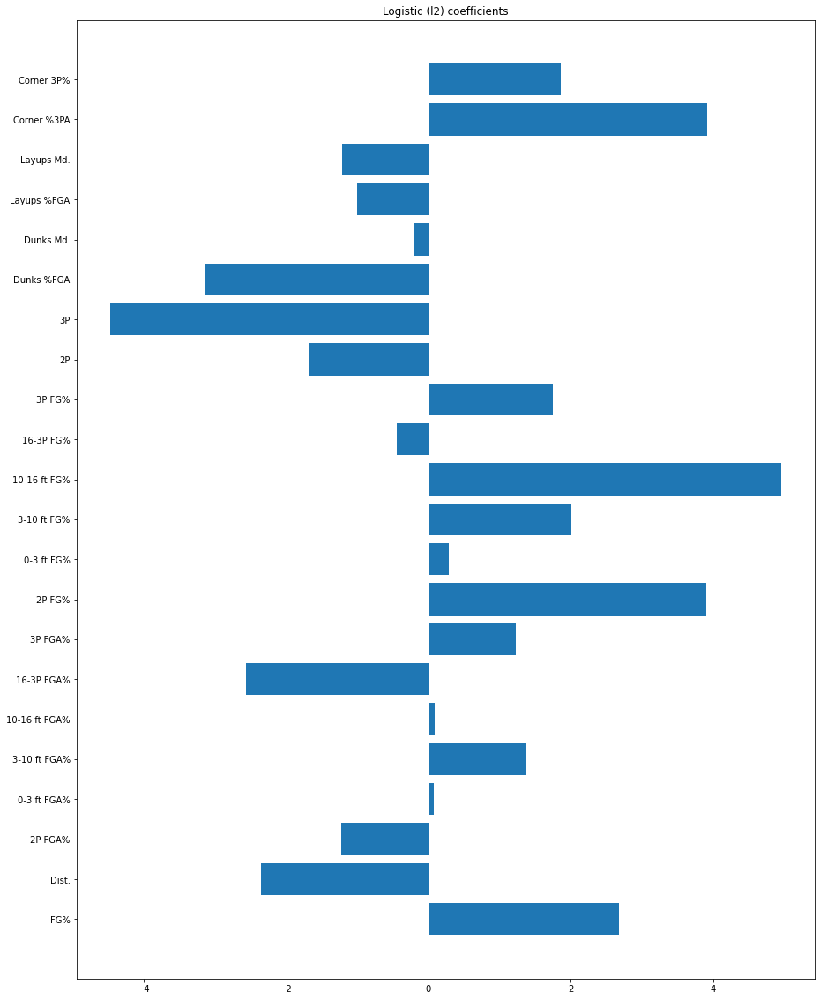

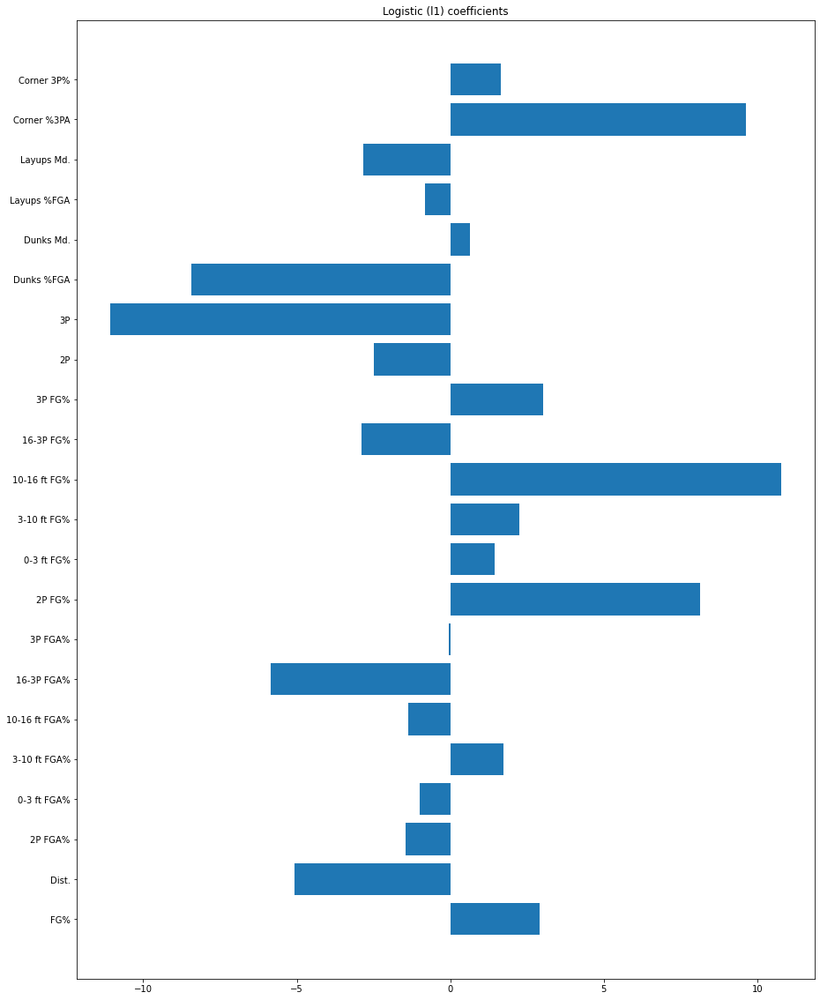

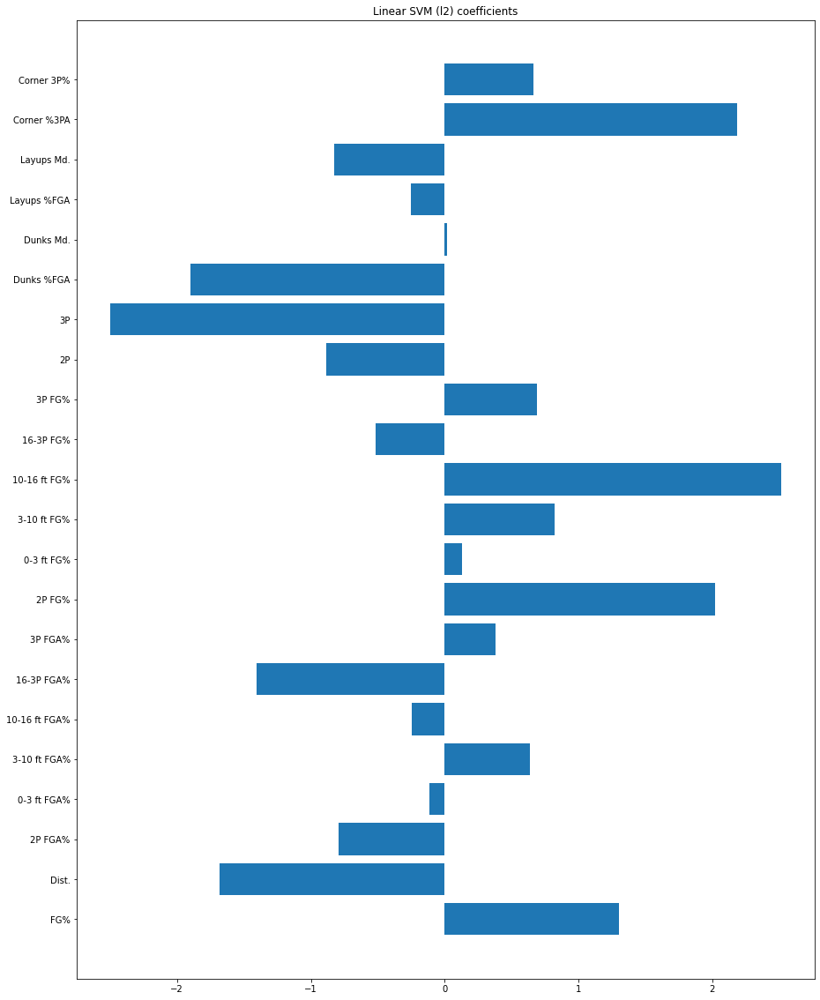

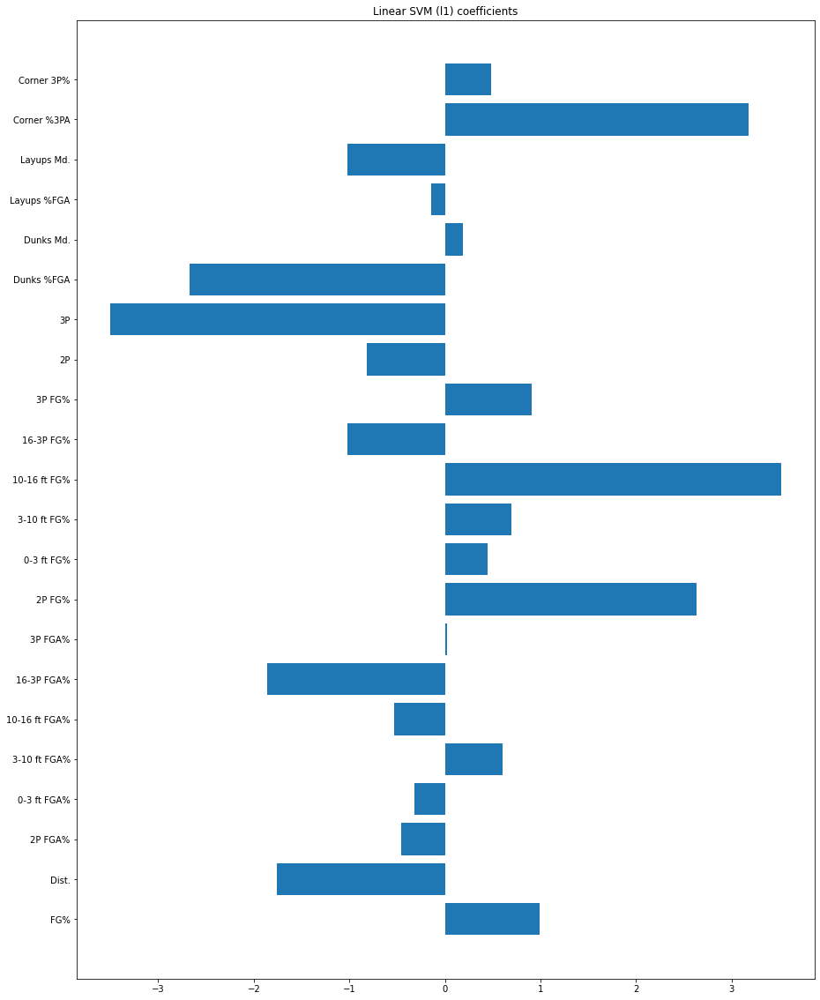

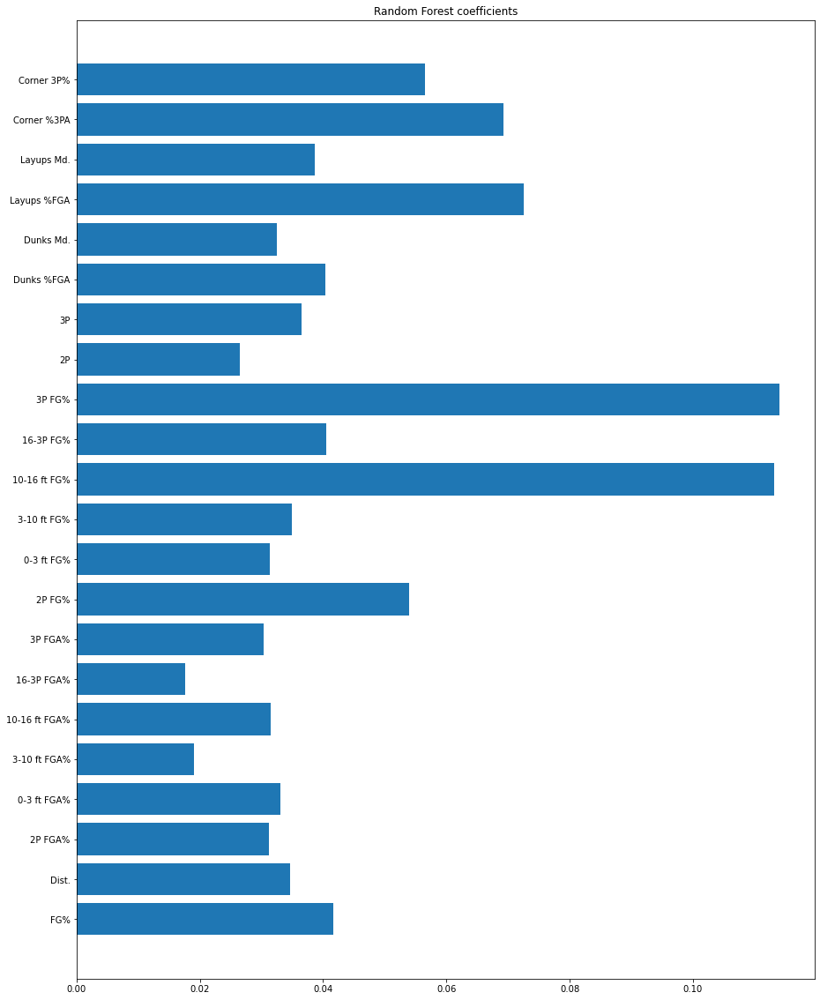

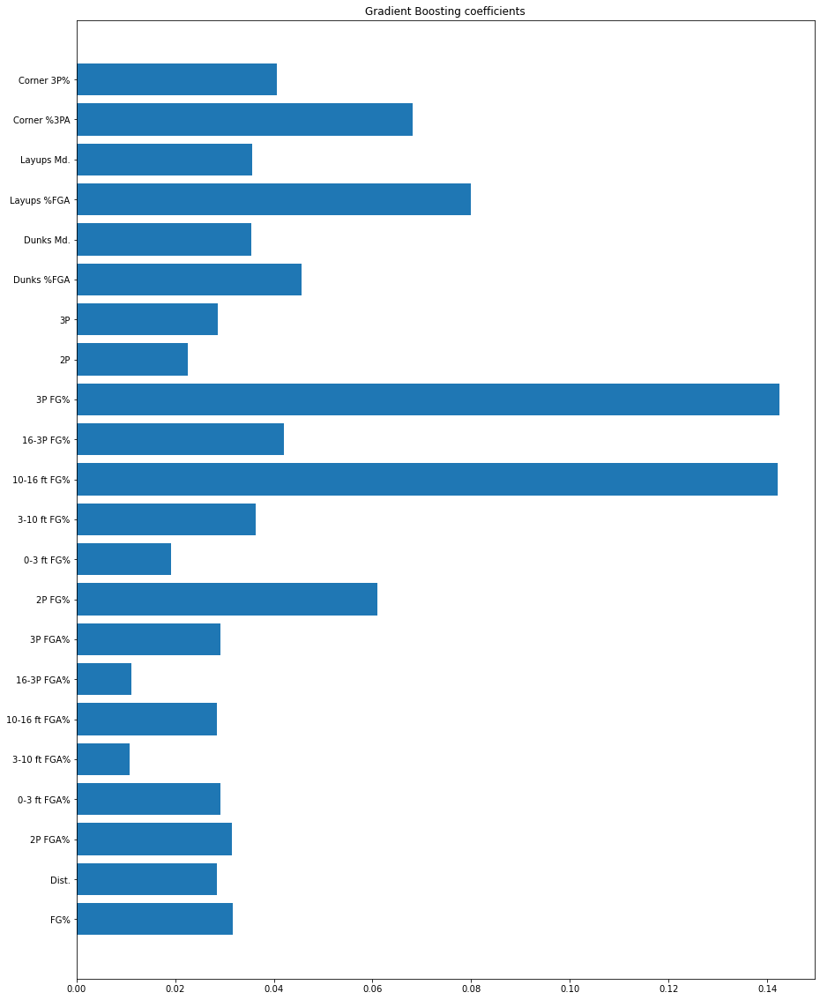

In [215]:
X = X_df

y = y

start_time = time.time()
a = train_knn(X,y)
print(a)
print("%s seconds" % a[4])

start_time = time.time()
b = train_logistic(X,y,reg='l2')
print(b)
print("%s seconds" % b[4])

start_time = time.time()
c = train_logistic(X,y,reg='l1')
print(c)
print("%s seconds" % c[4])

start_time = time.time()
d = train_svm(X,y,reg='l2')
print(d)
print("%s seconds" % d[4])

start_time = time.time()
e = train_svm(X,y,reg='l1')
print(e)
print("%s seconds" % e[4])

start_time = time.time()
f = train_RF(X,y,reg='none')
print(f)
print("%s seconds" % f[4])

start_time = time.time()
g = train_GBM(X,y,reg='none')
print(g)
print("%s seconds" % f[4])

## Test Performance

In [216]:
columns = ['Machine Learning Method', 'Test Accuracy',
        'Best Parameter', 'Top Predictor Variable', 'Run Time']
result = pd.DataFrame(columns=columns)
result.loc[0] = a
result.loc[1] = b
result.loc[2] = c
result.loc[3] = d
result.loc[4] = e
result.loc[5] = f
result.loc[6] = g
result

,Machine Learning Method,Test Accuracy,Best Parameter,Top Predictor Variable,Run Time
0,kNN,0.662500,N_Neighbor = 2,NA,139.215353
1,Logistic (l2),0.637500,C = 1,10-16 ft FG%,3.917897
2,Logistic (l1),0.570833,C = 3,3P,1.770935
3,LinearSVM (l2),0.554167,C = 1,10-16 ft FG%,1.907589
4,LinearSVM (l1),0.562500,C = 1,10-16 ft FG%,7.074812
5,Random Forest,0.683333,Max_features = 0.1,3P FG%,33.306932
6,Gradient Boosting Method,0.666667,Max_features = 0.1,3P FG%,12.366834


The shooting stats model testing shows just what kind of league the NBA is today - <b>one dominated from long range</b>. In contrast to the paint-centric play from Michael Jordan, Kareem Abdul-Jabbar and Wilt Chamberlain and their eras; today's NBA court is so much more stretched thanks to the introduction of the three-point line and zone defense, making it harder to attack the paint.

# Conclusion

Some key highlights, insights and recommendations:
1. Hyperparameter tuning can be used to improve the data pre-processing although it will increase computational expenditure.
2. Feature importance may change greatly should a data subset be altered.
2. I recommend that NBA teams refine three-point shooting. In this era of the NBA where zone defense is legal, the court is stretched, so the three-pointer is essential. 
3. Practice free throws. <i>"Ball don't lie"</i> as Rasheed Wallace likes to say. Free throws are the least contested points in the game, don't take them for granted. Drawing (and selling) fouls is an important skill in today's game as well, and free throws are the best way to capitalize off of this skill.
4. Improve defense too, scoring buckets isn't everything, defense wins championships and we've seen this from Bill Russell and his eleven rings.
5. When building a roster, take into account player age and maturity, and make sure that there are veterans on a team who could lead the team and help keep players in line and help nurture younger talents.

## References

"2021-22 NBA Season Summary." Basketball Reference, <i>Sports Reference</i>, https://www.basketball-reference.com/leagues/NBA_2022.html. Accessed 9 Nov 2022.